In [1]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t60p60.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los60.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

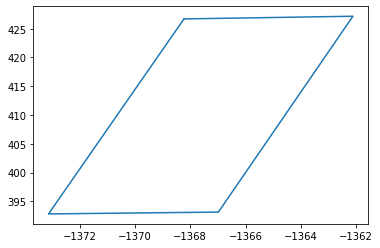

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

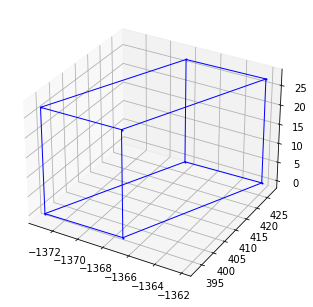

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▌                                                                              | 67/8644 [00:00<00:40, 209.78it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:16<00:00, 521.81it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+ 21*math.log10(d_3D)+ 20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [21]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [22]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=4.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [23]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= -6.77     #8- 10* math.log10(30) #N=30, for 38dbm=8db
#         LBuildingLoss=1
        interface1=TXPower+ G_5G_R-pathloss_UMi- LBodyLoss + G_Rx_5G
        return interface1,pathloss_UMi

In [24]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface2=TXPower+ G_5G_R-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa

In [25]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("fss_phi_difference:", fss_phi_difference)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface3=TXPower+ G_5G_R-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [26]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [27]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e3, interference_type=None)

x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, 0)
        FSS_Y = np.append(FSS_Y, 0)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e3, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 10)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W=np.empty([0])
    interface_UMa_W=np.empty([0])
    interface_RMa_W=np.empty([0])
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        for j in range(len(FSS_X)):
            if output: print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                     interface_UMi_W=np.append(interface_UMi_W,0)
#                     interface_UMa_W=np.append(interface_UMa_W,0)
#                     interface_RMa_W=np.append(interface_RMa_W,0)
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

                    theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    theta_tilt=10
                    
                    
#                   

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j],theta_tilt,phi_scan)
                        if output: print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference uma:", interfaceuma, "pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference rma:", interfacerma, "pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)

        interface_UMi_W = np.append(interface_UMi_W, np.sum(10 ** (interface_UMi_BS / 10)))
        interface_UMa_W = np.append(interface_UMa_W, np.sum(10 ** (interface_UMa_BS / 10)))
        interface_RMa_W = np.append(interface_RMa_W, np.sum(10 ** (interface_RMa_BS / 10)))
              
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi = interface_UMi_W / Noise_W
    if output: print('I/N UMi:', I_N_UMi)
    I_N_UMa = interface_UMa_W / Noise_W
    if output: print('I/N UMa:', I_N_UMa)      
    I_N_RMa = interface_RMa_W / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight
        

In [28]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
    if coarse:
        theta = round(theta, rounding_precision)
        phi = round(phi, rounding_precision)
    if (theta, phi) in saved_tp:
        # print(f'match found for ({theta}, {phi}), using that')
        return saved_tp.get((theta, phi))
    
    
    
    # return max_parameters
    # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
    result = optimize.brute(
        lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
        # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
        ranges = [(-90, 90), (-180, 180)]
        
    )
    saved_tp[(theta, phi)] = tuple(x for x in result)
    
    return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
    summation = 0
    # weighting multiplied by the superposition vector
    for n in range(1, rows+1):
        for m in range(1, cols+1):
            # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
            summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

    return abs(summation)**2

# antenna gain of 5G base station (represented by a single beam i)
def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
    beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

    return gain_antenna_element(theta, phi) + \
           10 * math.log10(beam_pattern)

# space refers to D/λ
def get_phi_min(space) -> float:
    # Rec. ITU-R S.465-6
    if space >= 50:
        return max(1.0, 100 * (1 / space))
    else:
        return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
def gain_fss_s1428(phi, phi_min) -> float:

    if 0 < phi < phi_min:
        return 32 - 25 * math.log10(phi_min)
    elif phi_min <= phi < 48:
        return 32 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -10

    # This function is only defined where phi is within (0, 180]
    raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [29]:
from tqdm import tqdm
distance_RMa, I_N_RMa_W, I_N_RMa_noAverage, distance_UMa, I_N_UMa_W, I_N_UMa_noAverage, distance_UMi, I_N_UMi_W, I_N_UMi_noAverage, line_of_sight = [np.empty([0]) for x in range(10)]
simulation_count = 10
for i in tqdm(range(simulation_count)):
   distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)

   distance_RMa = np.append(distance_RMa, distance_RMa_single)
   # print(I_N_RMa_single_W)
   I_N_RMa_W = np.append(I_N_RMa_W, I_N_RMa_single_W)
   I_N_RMa_noAverage = np.append(I_N_RMa_noAverage, 10 * np.log10(I_N_RMa_single_W))
   
   distance_UMa = np.append(distance_UMa, distance_UMa_single)
   I_N_UMa_W = np.append(I_N_UMa_W, I_N_UMa_single_W)
   I_N_UMa_noAverage = np.append(I_N_UMa_noAverage, 10 * np.log10(I_N_UMa_single_W))

   distance_UMi = np.append(distance_UMi, distance_UMi_single)
   I_N_UMi_W = np.append(I_N_UMi_W, I_N_UMi_single_W)
   I_N_UMi_noAverage = np.append(I_N_UMi_noAverage, 10 * np.log10(I_N_UMi_single_W))
    
   line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0
    
I_N_RMa = 10 * np.log10(np.average(I_N_RMa_W))
I_N_UMa = 10 * np.log10(np.average(I_N_UMa_W))
I_N_UMi = 10 * np.log10(np.average(I_N_UMi_W))

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 41%|███████████████████████████████▎                                             | 3329/8177 [00:07<00:12, 399.47it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7129/8177 [00:14<00:02, 412.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.16it/s]

 31%|███████████████████████▌                                                     | 2498/8177 [00:05<00:12, 447.89it/s]


 75%|██████████████████████████████████████████████████████████                   | 6160/8177 [00:12<00:03, 540.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.49it/s]

 18%|██████████████                                                               | 1492/8177 [00:03<00:11, 565.95it/s]


 63%|████████████████████████████████████████████████▎                            | 5132/8177 [00:11<00:06, 497.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.22it/s]

  6%|████▍                                                                         | 462/8177 [00:01<00:21, 365.69it/s]


 52%|███████████████████████████████████████▊                                     | 4231/8177 [00:09<00:07, 538.79it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:16<00:00, 522.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.87it/s]

 40%|██████████████████████████████▊                                              | 3275/8177 [00:07<00:13, 351.62it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7102/8177 [00:14<00:02, 391.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.26it/s]

 31%|███████████████████████▌                                                     | 2506/8177 [00:05<00:12, 454.99it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6258/8177 [00:12<00:03, 599.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 488.99it/s]

 19%|██████████████▎                                                              | 1514/8177 [00:03<00:12, 551.00it/s]


 63%|████████████████████████████████████████████████▏                            | 5111/8177 [00:11<00:06, 482.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.58it/s]

  4%|███▍                                                                          | 363/8177 [00:01<00:19, 398.96it/s]


 48%|█████████████████████████████████████                                        | 3934/8177 [00:08<00:07, 559.94it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7654/8177 [00:16<00:01, 356.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.51it/s]

 35%|███████████████████████████▏                                                 | 2891/8177 [00:06<00:10, 485.27it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6472/8177 [00:13<00:03, 508.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.92it/s]

 21%|████████████████▍                                                            | 1746/8177 [00:03<00:12, 520.97it/s]


 65%|██████████████████████████████████████████████████▎                          | 5339/8177 [00:11<00:05, 498.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.90it/s]

  7%|█████▎                                                                        | 560/8177 [00:01<00:23, 330.13it/s]


 52%|███████████████████████████████████████▋                                     | 4221/8177 [00:09<00:07, 528.46it/s]


 97%|██████████████████████████████████████████████████████████████████████████▌  | 7918/8177 [00:16<00:00, 458.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.11it/s]

 39%|█████████████████████████████▋                                               | 3149/8177 [00:07<00:12, 404.29it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6861/8177 [00:14<00:02, 548.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.82it/s]

 26%|████████████████████▏                                                        | 2140/8177 [00:04<00:12, 497.35it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5825/8177 [00:12<00:04, 508.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.32it/s]

 14%|██████████▍                                                                  | 1111/8177 [00:02<00:13, 525.20it/s]


 60%|██████████████████████████████████████████████                               | 4890/8177 [00:10<00:06, 509.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.99it/s]

  3%|██▏                                                                           | 235/8177 [00:00<00:21, 361.60it/s]


 47%|████████████████████████████████████▏                                        | 3849/8177 [00:08<00:07, 579.87it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7672/8177 [00:15<00:01, 361.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.84it/s]

 37%|████████████████████████████▎                                                | 3003/8177 [00:06<00:13, 373.23it/s]


 83%|████████████████████████████████████████████████████████████████             | 6801/8177 [00:13<00:02, 538.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.65it/s]

 26%|████████████████████▏                                                        | 2148/8177 [00:04<00:12, 501.18it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5832/8177 [00:12<00:04, 516.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.28it/s]

 13%|██████████▎                                                                  | 1099/8177 [00:02<00:13, 530.35it/s]


 59%|█████████████████████████████████████████████▍                               | 4824/8177 [00:10<00:06, 526.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.92it/s]

  2%|█▋                                                                            | 183/8177 [00:00<00:26, 299.54it/s]


 46%|███████████████████████████████████▏                                         | 3735/8177 [00:08<00:07, 574.28it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7511/8177 [00:15<00:01, 618.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.27it/s]

 34%|█████████████████████████▉                                                   | 2748/8177 [00:06<00:10, 535.20it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6397/8177 [00:13<00:03, 561.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.75it/s]

 20%|███████████████▋                                                             | 1665/8177 [00:03<00:13, 487.07it/s]


 65%|█████████████████████████████████████████████████▊                           | 5284/8177 [00:11<00:05, 504.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.51it/s]

  7%|█████▍                                                                        | 565/8177 [00:01<00:22, 344.67it/s]


 54%|█████████████████████████████████████████▌                                   | 4413/8177 [00:09<00:06, 548.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.48it/s]



 42%|███████████████████████████████▉                                             | 3396/8177 [00:07<00:10, 452.23it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7218/8177 [00:14<00:02, 472.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.48it/s]

 32%|████████████████████████▋                                                    | 2625/8177 [00:05<00:10, 506.08it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6327/8177 [00:13<00:03, 560.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.64it/s]

 20%|███████████████▎                                                             | 1626/8177 [00:03<00:13, 473.84it/s]


 65%|█████████████████████████████████████████████████▊                           | 5287/8177 [00:11<00:05, 490.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.67it/s]

  7%|█████▎                                                                        | 560/8177 [00:01<00:22, 331.31it/s]


 53%|████████████████████████████████████████▊                                    | 4335/8177 [00:09<00:06, 552.26it/s]


 99%|████████████████████████████████████████████████████████████████████████████▍| 8114/8177 [00:16<00:00, 529.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.80it/s]

 41%|███████████████████████████████▍                                             | 3334/8177 [00:07<00:11, 417.38it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7109/8177 [00:14<00:02, 399.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.45it/s]

 30%|███████████████████████▎                                                     | 2470/8177 [00:05<00:13, 422.49it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6134/8177 [00:12<00:03, 554.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.36it/s]

 17%|█████████████▏                                                               | 1400/8177 [00:03<00:12, 548.55it/s]


 62%|███████████████████████████████████████████████▋                             | 5064/8177 [00:10<00:05, 519.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.13it/s]

  4%|███                                                                           | 323/8177 [00:00<00:19, 402.41it/s]


 48%|████████████████████████████████████▌                                        | 3885/8177 [00:08<00:07, 542.02it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7648/8177 [00:16<00:01, 367.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.53it/s]

 35%|██████████████████████████▋                                                  | 2839/8177 [00:06<00:11, 464.09it/s]


 79%|████████████████████████████████████████████████████████████▍                | 6419/8177 [00:13<00:03, 527.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.74it/s]

 21%|███████████████▊                                                             | 1680/8177 [00:03<00:12, 517.31it/s]


 64%|█████████████████████████████████████████████████▌                           | 5260/8177 [00:11<00:06, 483.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.60it/s]

  5%|███▋                                                                          | 391/8177 [00:01<00:20, 381.94it/s]


 48%|████████████████████████████████████▊                                        | 3912/8177 [00:09<00:07, 542.16it/s]


 93%|███████████████████████████████████████████████████████████████████████▏     | 7564/8177 [00:16<00:01, 489.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.15it/s]

 36%|███████████████████████████▍                                                 | 2918/8177 [00:06<00:12, 405.77it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6626/8177 [00:13<00:03, 459.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.86it/s]

 24%|██████████████████▋                                                          | 1986/8177 [00:04<00:11, 546.37it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5719/8177 [00:11<00:04, 541.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 488.27it/s]

 13%|██████████▏                                                                  | 1081/8177 [00:02<00:13, 538.44it/s]


 59%|█████████████████████████████████████████████▌                               | 4835/8177 [00:10<00:06, 534.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.67it/s]

  3%|██▏                                                                           | 231/8177 [00:00<00:22, 355.99it/s]


 47%|████████████████████████████████████▌                                        | 3881/8177 [00:08<00:07, 573.18it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7672/8177 [00:15<00:01, 358.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.29it/s]

 37%|████████████████████████████▏                                                | 2996/8177 [00:06<00:14, 369.97it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6753/8177 [00:13<00:02, 536.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.91it/s]

 26%|███████████████████▋                                                         | 2092/8177 [00:04<00:12, 486.90it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5838/8177 [00:12<00:04, 514.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.79it/s]

 15%|███████████▎                                                                 | 1199/8177 [00:02<00:14, 466.28it/s]


 61%|██████████████████████████████████████████████▋                              | 4960/8177 [00:10<00:06, 512.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.67it/s]

  4%|███                                                                           | 327/8177 [00:00<00:19, 407.88it/s]


 49%|█████████████████████████████████████▋                                       | 4001/8177 [00:08<00:07, 531.91it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7752/8177 [00:16<00:01, 358.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.16it/s]

 37%|████████████████████████████▋                                                | 3053/8177 [00:06<00:13, 381.93it/s]


 83%|████████████████████████████████████████████████████████████████             | 6808/8177 [00:13<00:02, 538.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.10it/s]

 26%|███████████████████▋                                                         | 2092/8177 [00:04<00:12, 483.73it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5796/8177 [00:12<00:04, 499.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.27it/s]

 13%|██████████                                                                   | 1073/8177 [00:02<00:12, 548.02it/s]


 60%|█████████████████████████████████████████████▉                               | 4883/8177 [00:10<00:06, 511.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.01it/s]

  3%|██▏                                                                           | 231/8177 [00:00<00:22, 350.01it/s]


 47%|████████████████████████████████████▎                                        | 3854/8177 [00:08<00:07, 563.76it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7629/8177 [00:15<00:01, 405.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.55it/s]

 35%|███████████████████████████                                                  | 2876/8177 [00:06<00:10, 482.71it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6570/8177 [00:13<00:02, 540.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.29it/s]

 23%|█████████████████▌                                                           | 1861/8177 [00:04<00:12, 519.60it/s]


 68%|████████████████████████████████████████████████████                         | 5523/8177 [00:11<00:04, 540.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.72it/s]

  9%|███████▎                                                                      | 769/8177 [00:02<00:15, 475.90it/s]


 55%|██████████████████████████████████████████▎                                  | 4489/8177 [00:09<00:06, 582.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.55it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 42%|████████████████████████████████▍                                            | 3445/8177 [00:07<00:10, 459.58it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7223/8177 [00:14<00:01, 477.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.75it/s]

 31%|████████████████████████▏                                                    | 2562/8177 [00:05<00:12, 453.45it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6285/8177 [00:12<00:03, 574.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.54it/s]

 19%|██████████████▊                                                              | 1569/8177 [00:03<00:11, 572.44it/s]


 64%|█████████████████████████████████████████████████▍                           | 5255/8177 [00:11<00:05, 506.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.61it/s]

  7%|█████                                                                         | 534/8177 [00:01<00:20, 370.98it/s]


 53%|█████████████████████████████████████████                                    | 4357/8177 [00:09<00:06, 552.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 491.15it/s]



 42%|████████████████████████████████▌                                            | 3455/8177 [00:07<00:09, 476.73it/s]


 90%|█████████████████████████████████████████████████████████████████████▏       | 7345/8177 [00:14<00:01, 571.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.61it/s]

 34%|█████████████████████████▉                                                   | 2759/8177 [00:05<00:09, 547.00it/s]


 79%|█████████████████████████████████████████████████████████████                | 6484/8177 [00:13<00:03, 528.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.79it/s]

 22%|█████████████████                                                            | 1814/8177 [00:04<00:11, 555.24it/s]


 67%|███████████████████████████████████████████████████▋                         | 5490/8177 [00:11<00:04, 544.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.49it/s]

  9%|███████▎                                                                      | 769/8177 [00:02<00:15, 479.21it/s]


 55%|██████████████████████████████████████████▎                                  | 4489/8177 [00:09<00:06, 580.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.15it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:29, 278.80it/s]


 43%|█████████████████████████████████▍                                           | 3552/8177 [00:07<00:08, 531.04it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7408/8177 [00:15<00:01, 630.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.47it/s]

 32%|████████████████████████▋                                                    | 2620/8177 [00:05<00:11, 492.91it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6188/8177 [00:13<00:03, 536.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.24it/s]

 17%|█████████████                                                                | 1384/8177 [00:03<00:12, 546.50it/s]


 61%|███████████████████████████████████████████████▎                             | 5019/8177 [00:10<00:06, 505.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.45it/s]

  3%|██▋                                                                           | 278/8177 [00:00<00:20, 384.55it/s]


 47%|████████████████████████████████████▏                                        | 3837/8177 [00:08<00:07, 558.09it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7524/8177 [00:15<00:01, 514.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.76it/s]

 34%|██████████████████████████                                                   | 2764/8177 [00:06<00:09, 542.50it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6446/8177 [00:13<00:03, 533.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.19it/s]

 21%|████████████████▍                                                            | 1747/8177 [00:04<00:12, 524.64it/s]


 67%|███████████████████████████████████████████████████▋                         | 5489/8177 [00:11<00:04, 538.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.36it/s]

  9%|██████▋                                                                       | 702/8177 [00:01<00:17, 439.70it/s]


 56%|██████████████████████████████████████████▊                                  | 4542/8177 [00:09<00:06, 570.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.98it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:29, 273.56it/s]


 44%|█████████████████████████████████▋                                           | 3581/8177 [00:07<00:08, 566.15it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7443/8177 [00:15<00:01, 636.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.59it/s]

 34%|██████████████████████████▍                                                  | 2811/8177 [00:06<00:10, 495.94it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6576/8177 [00:13<00:02, 535.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 490.65it/s]

 24%|██████████████████▏                                                          | 1931/8177 [00:04<00:11, 525.73it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5705/8177 [00:11<00:04, 569.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 490.84it/s]

 11%|████████▉                                                                     | 940/8177 [00:02<00:14, 515.95it/s]


 58%|████████████████████████████████████████████▍                                | 4713/8177 [00:10<00:06, 558.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.06it/s]

  1%|▊                                                                              | 81/8177 [00:00<00:39, 205.51it/s]


 44%|█████████████████████████████████▉                                           | 3601/8177 [00:08<00:07, 573.61it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7369/8177 [00:15<00:01, 604.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.00it/s]

 33%|█████████████████████████▎                                                   | 2686/8177 [00:06<00:10, 541.76it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6347/8177 [00:13<00:03, 560.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.81it/s]

 20%|███████████████                                                              | 1596/8177 [00:03<00:13, 470.41it/s]


 65%|█████████████████████████████████████████████████▊                           | 5288/8177 [00:11<00:05, 499.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.70it/s]

  6%|████▉                                                                         | 517/8177 [00:01<00:22, 337.44it/s]


 52%|███████████████████████████████████████▊                                     | 4226/8177 [00:09<00:07, 546.02it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7988/8177 [00:16<00:00, 520.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.98it/s]

 38%|█████████████████████████████▎                                               | 3119/8177 [00:07<00:12, 415.63it/s]


 83%|████████████████████████████████████████████████████████████████             | 6803/8177 [00:14<00:02, 506.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.97it/s]

 26%|███████████████████▋                                                         | 2087/8177 [00:04<00:12, 472.50it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5691/8177 [00:12<00:04, 550.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.01it/s]

 11%|████████▉                                                                     | 940/8177 [00:02<00:13, 523.27it/s]


 58%|████████████████████████████████████████████▍                                | 4725/8177 [00:10<00:06, 540.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.24it/s]

  1%|█                                                                             | 113/8177 [00:00<00:33, 237.21it/s]


 45%|██████████████████████████████████▍                                          | 3662/8177 [00:08<00:07, 588.60it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7424/8177 [00:15<00:01, 597.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.47it/s]

 34%|█████████████████████████▊                                                   | 2745/8177 [00:06<00:10, 533.70it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6396/8177 [00:13<00:03, 584.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.51it/s]

 21%|████████████████                                                             | 1707/8177 [00:03<00:12, 538.48it/s]


 66%|██████████████████████████████████████████████████▌                          | 5364/8177 [00:11<00:05, 519.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.81it/s]

  7%|█████▋                                                                        | 598/8177 [00:01<00:23, 322.48it/s]


 53%|█████████████████████████████████████████                                    | 4354/8177 [00:09<00:07, 542.46it/s]


 99%|████████████████████████████████████████████████████████████████████████████▍| 8116/8177 [00:16<00:00, 533.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.25it/s]

 42%|███████████████████████████████▉                                             | 3396/8177 [00:07<00:10, 453.84it/s]


 87%|███████████████████████████████████████████████████████████████████▎         | 7152/8177 [00:14<00:02, 409.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.37it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:05<00:12, 443.05it/s]


 77%|███████████████████████████████████████████████████████████                  | 6277/8177 [00:12<00:03, 581.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.03it/s]

 21%|████████████████                                                             | 1701/8177 [00:03<00:11, 548.84it/s]


 67%|███████████████████████████████████████████████████▎                         | 5450/8177 [00:11<00:04, 565.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 490.53it/s]

  9%|███████                                                                       | 741/8177 [00:01<00:15, 495.23it/s]


 56%|███████████████████████████████████████████▍                                 | 4612/8177 [00:09<00:06, 559.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.47it/s]

  1%|▊                                                                              | 86/8177 [00:00<00:36, 222.20it/s]


 46%|███████████████████████████████████                                          | 3722/8177 [00:08<00:07, 579.65it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7572/8177 [00:15<00:01, 495.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 488.53it/s]

 35%|███████████████████████████                                                  | 2870/8177 [00:06<00:10, 491.92it/s]


 81%|██████████████████████████████████████████████████████████████               | 6585/8177 [00:13<00:03, 489.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.65it/s]

 24%|██████████████████▏                                                          | 1927/8177 [00:04<00:12, 518.12it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5674/8177 [00:11<00:04, 556.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 488.69it/s]

 12%|█████████▌                                                                   | 1020/8177 [00:02<00:11, 641.93it/s]


 59%|█████████████████████████████████████████████▍                               | 4825/8177 [00:10<00:06, 520.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.15it/s]

  2%|█▊                                                                            | 188/8177 [00:00<00:26, 304.89it/s]


 48%|████████████████████████████████████▊                                        | 3909/8177 [00:08<00:07, 586.28it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7712/8177 [00:15<00:01, 341.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 490.15it/s]

 60%|█████████████████████████████████████████████▉                               | 4873/8177 [00:06<00:03, 853.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.56it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 718.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.17it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 469.92it/s]


 70%|██████████████████████████████████████████████████████                       | 5735/8177 [00:07<00:02, 870.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.40it/s]

 39%|█████████████████████████████▊                                               | 3164/8177 [00:04<00:07, 635.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.66it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 548.93it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6562/8177 [00:08<00:01, 850.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.98it/s]

 48%|████████████████████████████████████▉                                        | 3917/8177 [00:05<00:04, 908.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.40it/s]

  9%|███████▏                                                                      | 759/8177 [00:02<00:15, 476.72it/s]


 55%|██████████████████████████████████████████▋                                  | 4536/8177 [00:09<00:06, 565.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.24it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:29, 273.51it/s]


 42%|████████████████████████████████▌                                            | 3459/8177 [00:07<00:10, 463.59it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7237/8177 [00:15<00:02, 464.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.23it/s]

 31%|███████████████████████▉                                                     | 2536/8177 [00:05<00:12, 454.76it/s]


 76%|██████████████████████████████████████████████████████████▋                  | 6231/8177 [00:12<00:03, 582.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.34it/s]

 18%|██████████████▏                                                              | 1510/8177 [00:03<00:11, 562.62it/s]


 63%|████████████████████████████████████████████████▊                            | 5182/8177 [00:11<00:06, 490.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.79it/s]

  6%|████▋                                                                         | 491/8177 [00:01<00:22, 347.27it/s]


 51%|██████████████████████████████████████▉                                      | 4141/8177 [00:09<00:07, 563.35it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7868/8177 [00:16<00:00, 440.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.80it/s]

 38%|█████████████████████████████▎                                               | 3111/8177 [00:07<00:12, 419.56it/s]


 83%|███████████████████████████████████████████████████████████████▊             | 6774/8177 [00:14<00:02, 541.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.07it/s]
C:\Users\tniloy\AppData\Local\Temp\ipykernel_31668\1786364909.py:10: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa_noAverage = np.append(I_N_RMa_noAverage, 10 * np.log10(I_N_RMa_single_W))
C:\Users\tniloy\AppData\Local\Temp\ipykernel_31668\1786364909.py:14: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa_noAverage = np.append(I_N_UMa_noAverage, 10 * np.log10(I_N_UMa_single_W))
 37%|████████████████████████████▌                                                | 3029/8177 [00:04<00:08, 641.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.37it/s]

  7%|█████▏                                                                        | 544/8177 [00:00<00:13, 576.35it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6535/8177 [00:08<00:01, 863.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.52it/s]

 50%|██████████████████████████████████████▊                                      | 4118/8177 [00:05<00:04, 901.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.52it/s]

 20%|███████████████▋                                                             | 1661/8177 [00:02<00:07, 847.91it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 805.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.98it/s]

 62%|███████████████████████████████████████████████▌                             | 5045/8177 [00:06<00:03, 863.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.28it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 710.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.94it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:19, 406.24it/s]


 74%|█████████████████████████████████████████████████████████                    | 6059/8177 [00:07<00:02, 897.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.68it/s]

 43%|█████████████████████████████████▎                                           | 3537/8177 [00:04<00:05, 799.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.46it/s]

 15%|███████████▎                                                                 | 1207/8177 [00:01<00:09, 772.62it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 732.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.50it/s]

 60%|██████████████████████████████████████████████                               | 4890/8177 [00:06<00:03, 854.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.67it/s]

 29%|██████████████████████▋                                                      | 2411/8177 [00:03<00:09, 623.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.02it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:22, 364.18it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5793/8177 [00:07<00:02, 853.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.97it/s]

 41%|███████████████████████████████▌                                             | 3353/8177 [00:04<00:07, 668.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.08it/s]

 12%|█████████                                                                     | 949/8177 [00:01<00:09, 777.89it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6992/8177 [00:08<00:01, 851.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.53it/s]

 54%|█████████████████████████████████████████▍                                   | 4395/8177 [00:05<00:04, 914.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.44it/s]

 24%|██████████████████▏                                                          | 1926/8177 [00:02<00:07, 832.15it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7861/8177 [00:10<00:00, 698.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.00it/s]

 66%|██████████████████████████████████████████████████▊                          | 5401/8177 [00:06<00:03, 865.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.96it/s]

 35%|███████████████████████████                                                  | 2879/8177 [00:03<00:06, 785.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.53it/s]

  5%|████                                                                          | 427/8177 [00:00<00:12, 613.44it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6451/8177 [00:08<00:01, 901.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.40it/s]

 49%|█████████████████████████████████████▊                                       | 4016/8177 [00:05<00:04, 891.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.56it/s]

 20%|███████████████                                                              | 1595/8177 [00:02<00:07, 825.21it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7645/8177 [00:09<00:00, 678.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.18it/s]

 62%|███████████████████████████████████████████████▋                             | 5061/8177 [00:06<00:03, 868.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.54it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 714.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.16it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:19, 405.14it/s]


 73%|████████████████████████████████████████████████████████                     | 5952/8177 [00:07<00:02, 843.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.42it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 663.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.21it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:09, 751.46it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6904/8177 [00:08<00:01, 886.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.20it/s]

 54%|█████████████████████████████████████████▌                                   | 4410/8177 [00:05<00:04, 923.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.75it/s]

 25%|██████████████████▉                                                          | 2017/8177 [00:02<00:07, 842.30it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7980/8177 [00:10<00:00, 786.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.07it/s]

 66%|██████████████████████████████████████████████████▊                          | 5395/8177 [00:06<00:03, 859.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.14it/s]

 35%|███████████████████████████▏                                                 | 2889/8177 [00:03<00:06, 805.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.88it/s]

  6%|████▌                                                                         | 481/8177 [00:00<00:13, 566.94it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6362/8177 [00:08<00:02, 903.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.22it/s]

 45%|██████████████████████████████████▉                                          | 3716/8177 [00:05<00:05, 876.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.00it/s]

 14%|██████████▊                                                                  | 1147/8177 [00:01<00:09, 738.28it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7017/8177 [00:09<00:01, 758.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.60it/s]

 54%|█████████████████████████████████████████▎                                   | 4387/8177 [00:05<00:04, 905.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.01it/s]

 24%|██████████████████▌                                                          | 1974/8177 [00:02<00:07, 872.09it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7992/8177 [00:10<00:00, 800.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.35it/s]

 66%|██████████████████████████████████████████████████▉                          | 5405/8177 [00:06<00:03, 868.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.17it/s]

 36%|███████████████████████████▌                                                 | 2932/8177 [00:04<00:07, 683.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.72it/s]

  5%|████                                                                          | 425/8177 [00:00<00:12, 605.40it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6346/8177 [00:08<00:02, 904.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.59it/s]

 46%|███████████████████████████████████                                          | 3729/8177 [00:05<00:05, 885.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.35it/s]

 16%|████████████▎                                                                | 1313/8177 [00:01<00:08, 837.85it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7234/8177 [00:09<00:01, 732.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.35it/s]

 57%|████████████████████████████████████████████                                 | 4683/8177 [00:06<00:03, 921.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.90it/s]

 27%|████████████████████▌                                                        | 2181/8177 [00:03<00:08, 733.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.92it/s]



 68%|████████████████████████████████████████████████████▍                        | 5565/8177 [00:07<00:02, 891.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.41it/s]

 38%|█████████████████████████████▎                                               | 3112/8177 [00:04<00:07, 678.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.29it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 551.57it/s]


 81%|██████████████████████████████████████████████████████████████               | 6591/8177 [00:08<00:01, 794.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.27it/s]

 49%|█████████████████████████████████████▌                                       | 3993/8177 [00:05<00:04, 878.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.67it/s]

 19%|██████████████▋                                                              | 1566/8177 [00:02<00:07, 906.57it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7512/8177 [00:09<00:00, 934.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.65it/s]

 60%|██████████████████████████████████████████████▌                              | 4944/8177 [00:06<00:03, 851.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.63it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 617.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.31it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 375.80it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5839/8177 [00:07<00:02, 839.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.12it/s]

 40%|██████████████████████████████▌                                              | 3247/8177 [00:04<00:08, 565.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.19it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 680.48it/s]


 83%|███████████████████████████████████████████████████████████████▊             | 6774/8177 [00:08<00:01, 879.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.59it/s]

 51%|███████████████████████████████████████▌                                     | 4200/8177 [00:05<00:04, 875.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.17it/s]

 21%|████████████████▍                                                            | 1745/8177 [00:02<00:07, 845.17it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7681/8177 [00:09<00:00, 610.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.74it/s]

 63%|████████████████████████████████████████████████▎                            | 5133/8177 [00:06<00:03, 839.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.91it/s]

 33%|█████████████████████████▍                                                   | 2706/8177 [00:03<00:06, 827.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.94it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 620.31it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6067/8177 [00:07<00:02, 883.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.99it/s]

 42%|████████████████████████████████▎                                            | 3426/8177 [00:04<00:06, 700.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.73it/s]

 12%|█████████▎                                                                    | 977/8177 [00:01<00:08, 854.05it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6937/8177 [00:08<00:01, 842.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.82it/s]

 54%|█████████████████████████████████████████▎                                   | 4393/8177 [00:05<00:04, 917.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.20it/s]

 24%|██████████████████                                                           | 1922/8177 [00:02<00:07, 822.39it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7861/8177 [00:10<00:00, 698.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.09it/s]

 65%|█████████████████████████████████████████████████▊                           | 5289/8177 [00:06<00:03, 832.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.53it/s]

 34%|██████████████████████████▎                                                  | 2792/8177 [00:03<00:06, 835.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.33it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:12, 636.27it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6342/8177 [00:07<00:02, 908.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.34it/s]

 46%|███████████████████████████████████▏                                         | 3741/8177 [00:05<00:04, 895.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.53it/s]

 16%|████████████▎                                                                | 1312/8177 [00:01<00:08, 840.50it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7303/8177 [00:09<00:01, 792.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.16it/s]

 58%|█████████████████████████████████████████████                                | 4780/8177 [00:06<00:03, 878.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.81it/s]

 28%|█████████████████████▎                                                       | 2260/8177 [00:03<00:08, 728.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.95it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|██████████████████████████████████████████████████████▎                      | 5762/8177 [00:07<00:02, 869.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.10it/s]

 39%|█████████████████████████████▋                                               | 3152/8177 [00:04<00:07, 668.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.00it/s]

  9%|██████▋                                                                       | 706/8177 [00:01<00:10, 682.68it/s]


 82%|██████████████████████████████████████████████████████████████▉              | 6678/8177 [00:08<00:01, 827.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.66it/s]

 50%|██████████████████████████████████████▋                                      | 4110/8177 [00:05<00:04, 907.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.72it/s]

 20%|███████████████▋                                                             | 1661/8177 [00:02<00:07, 843.02it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7634/8177 [00:09<00:00, 707.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.69it/s]

 62%|███████████████████████████████████████████████▌                             | 5055/8177 [00:06<00:03, 849.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.30it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 718.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.17it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 400.50it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5901/8177 [00:07<00:02, 841.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.42it/s]

 40%|██████████████████████████████▌                                              | 3242/8177 [00:04<00:08, 557.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.35it/s]

  8%|██████▌                                                                       | 692/8177 [00:01<00:11, 649.70it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6643/8177 [00:08<00:01, 785.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.38it/s]

 50%|██████████████████████████████████████▋                                      | 4112/8177 [00:05<00:04, 911.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.11it/s]

 20%|███████████████▋                                                             | 1663/8177 [00:02<00:07, 855.94it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7635/8177 [00:09<00:00, 698.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.43it/s]

 62%|███████████████████████████████████████████████▍                             | 5043/8177 [00:06<00:03, 862.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.20it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 716.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.06it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:15, 501.97it/s]


 74%|█████████████████████████████████████████████████████████                    | 6055/8177 [00:07<00:02, 897.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.17it/s]

 42%|████████████████████████████████▎                                            | 3431/8177 [00:04<00:06, 713.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.45it/s]

 12%|█████████▍                                                                   | 1000/8177 [00:01<00:08, 892.34it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6974/8177 [00:08<00:01, 868.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.23it/s]

 54%|█████████████████████████████████████████▎                                   | 4392/8177 [00:05<00:04, 914.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.92it/s]

 23%|██████████████████                                                           | 1921/8177 [00:02<00:07, 826.07it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7880/8177 [00:10<00:00, 701.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.83it/s]

 65%|█████████████████████████████████████████████████▉                           | 5308/8177 [00:06<00:03, 847.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.22it/s]

 34%|██████████████████████████▎                                                  | 2791/8177 [00:03<00:06, 839.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.93it/s]

  4%|███▍                                                                          | 359/8177 [00:00<00:12, 633.93it/s]


 76%|██████████████████████████████████████████████████████████▋                  | 6231/8177 [00:07<00:02, 920.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.97it/s]

 45%|██████████████████████████████████▎                                          | 3642/8177 [00:04<00:05, 879.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.44it/s]

 14%|███████████                                                                  | 1177/8177 [00:01<00:09, 754.99it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7135/8177 [00:09<00:01, 703.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.04it/s]

 57%|████████████████████████████████████████████                                 | 4685/8177 [00:06<00:03, 928.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.65it/s]

 27%|████████████████████▌                                                        | 2182/8177 [00:02<00:08, 740.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.77it/s]



 68%|████████████████████████████████████████████████████▋                        | 5600/8177 [00:07<00:02, 888.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.87it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 676.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.01it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:13, 547.17it/s]


 81%|█████████████████████████████████████████████████████████████▉               | 6584/8177 [00:08<00:01, 824.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.57it/s]

 47%|████████████████████████████████████▍                                        | 3868/8177 [00:05<00:04, 888.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.06it/s]

 18%|██████████████                                                               | 1497/8177 [00:02<00:07, 877.54it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7561/8177 [00:09<00:00, 826.34it/s]


 61%|██████████████████████████████████████████████▋                              | 4954/8177 [00:06<00:03, 853.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.62it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 626.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.90it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 375.58it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5871/8177 [00:07<00:02, 849.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.00it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 664.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.18it/s]

 10%|████████                                                                      | 851/8177 [00:01<00:10, 710.72it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6899/8177 [00:08<00:01, 890.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.73it/s]

 53%|████████████████████████████████████████▌                                    | 4310/8177 [00:05<00:04, 920.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.46it/s]

 23%|█████████████████▎                                                           | 1842/8177 [00:02<00:07, 871.68it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7840/8177 [00:09<00:00, 693.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.80it/s]

 66%|██████████████████████████████████████████████████▉                          | 5409/8177 [00:06<00:03, 859.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.88it/s]

 35%|███████████████████████████                                                  | 2880/8177 [00:03<00:06, 787.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.46it/s]

  5%|████                                                                          | 426/8177 [00:00<00:12, 611.52it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6412/8177 [00:08<00:01, 909.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.02it/s]

 47%|████████████████████████████████████                                         | 3832/8177 [00:05<00:04, 900.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.40it/s]

 17%|█████████████▎                                                               | 1409/8177 [00:02<00:07, 868.75it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7450/8177 [00:09<00:00, 933.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.91it/s]

 60%|█████████████████████████████████████████████▊                               | 4868/8177 [00:06<00:03, 854.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.40it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 723.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.77it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 468.22it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5728/8177 [00:07<00:02, 859.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 800.58it/s]

 40%|███████████████████████████████▏                                             | 3311/8177 [00:04<00:07, 634.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.60it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 678.30it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6763/8177 [00:08<00:01, 861.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.92it/s]

 51%|███████████████████████████████████████▍                                     | 4187/8177 [00:05<00:04, 852.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.24it/s]

 21%|████████████████▍                                                            | 1748/8177 [00:02<00:07, 849.10it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7704/8177 [00:09<00:00, 608.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.02it/s]

 64%|█████████████████████████████████████████████████▎                           | 5236/8177 [00:06<00:03, 854.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.56it/s]

 34%|██████████████████████████▎                                                  | 2795/8177 [00:03<00:06, 831.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.09it/s]

  4%|███▍                                                                          | 360/8177 [00:00<00:12, 636.38it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6326/8177 [00:07<00:02, 920.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.94it/s]

 46%|███████████████████████████████████▏                                         | 3736/8177 [00:05<00:04, 888.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.25it/s]

 16%|████████████                                                                 | 1286/8177 [00:01<00:08, 825.06it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7226/8177 [00:09<00:01, 738.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.47it/s]

 57%|████████████████████████████████████████████▏                                | 4698/8177 [00:06<00:03, 927.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.67it/s]

 27%|█████████████████████▏                                                       | 2244/8177 [00:03<00:08, 717.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.77it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:17, 465.60it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5866/8177 [00:07<00:02, 846.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.94it/s]

 40%|██████████████████████████████▌                                              | 3248/8177 [00:04<00:08, 565.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.84it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 680.62it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6791/8177 [00:08<00:01, 879.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.73it/s]

 51%|███████████████████████████████████████▌                                     | 4202/8177 [00:05<00:04, 885.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.74it/s]

 21%|████████████████▎                                                            | 1733/8177 [00:02<00:07, 854.17it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7663/8177 [00:09<00:00, 631.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.64it/s]

 62%|███████████████████████████████████████████████▎                             | 5029/8177 [00:06<00:03, 851.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.50it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 611.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.61it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 468.91it/s]


 72%|███████████████████████████████████████████████████████                      | 5847/8177 [00:07<00:02, 845.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.58it/s]

 40%|██████████████████████████████▋                                              | 3256/8177 [00:04<00:08, 572.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.29it/s]

 10%|███████▍                                                                      | 785/8177 [00:01<00:11, 654.23it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6917/8177 [00:08<00:01, 869.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.81it/s]

 54%|█████████████████████████████████████████▎                                   | 4393/8177 [00:05<00:04, 913.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.97it/s]

 24%|██████████████████▌                                                          | 1969/8177 [00:02<00:07, 865.77it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8011/8177 [00:10<00:00, 740.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.01it/s]

 67%|███████████████████████████████████████████████████▊                         | 5498/8177 [00:07<00:03, 877.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.06it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 666.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.48it/s]

  6%|████▋                                                                         | 489/8177 [00:00<00:13, 579.27it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6433/8177 [00:08<00:01, 910.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.47it/s]

 47%|████████████████████████████████████                                         | 3832/8177 [00:05<00:04, 899.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.23it/s]

 17%|████████████▊                                                                | 1357/8177 [00:01<00:08, 847.54it/s]


 90%|█████████████████████████████████████████████████████████████████████        | 7336/8177 [00:09<00:01, 839.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.25it/s]

 60%|█████████████████████████████████████████████▉                               | 4884/8177 [00:06<00:03, 855.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.70it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 625.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.16it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 374.45it/s]


 72%|███████████████████████████████████████████████████████                      | 5853/8177 [00:07<00:02, 841.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.87it/s]

 41%|███████████████████████████████▍                                             | 3344/8177 [00:04<00:07, 663.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.96it/s]

 11%|████████▍                                                                     | 886/8177 [00:01<00:09, 753.87it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6954/8177 [00:08<00:01, 849.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.24it/s]

 55%|██████████████████████████████████████████▍                                  | 4508/8177 [00:05<00:03, 954.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.36it/s]

 25%|███████████████████▍                                                         | 2068/8177 [00:02<00:07, 818.62it/s]


 99%|████████████████████████████████████████████████████████████████████████████▏| 8088/8177 [00:10<00:00, 814.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.57it/s]

 68%|████████████████████████████████████████████████████▋                        | 5599/8177 [00:07<00:02, 895.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.33it/s]

 39%|█████████████████████████████▉                                               | 3176/8177 [00:04<00:07, 650.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.13it/s]

 10%|███████▍                                                                      | 781/8177 [00:01<00:11, 655.62it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6905/8177 [00:08<00:01, 881.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.84it/s]

 54%|█████████████████████████████████████████▌                                   | 4413/8177 [00:05<00:04, 927.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 792.49it/s]

 25%|███████████████████                                                          | 2018/8177 [00:02<00:07, 836.21it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7990/8177 [00:10<00:00, 805.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.19it/s]

 66%|██████████████████████████████████████████████████▋                          | 5377/8177 [00:06<00:03, 847.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.39it/s]

 35%|███████████████████████████▏                                                 | 2889/8177 [00:03<00:06, 804.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.12it/s]

  5%|████                                                                          | 426/8177 [00:00<00:12, 612.11it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6442/8177 [00:08<00:01, 905.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.79it/s]

 48%|████████████████████████████████████▉                                        | 3921/8177 [00:05<00:04, 904.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.14it/s]

 18%|██████████████▏                                                              | 1506/8177 [00:02<00:07, 894.29it/s]


 93%|███████████████████████████████████████████████████████████████████████▏     | 7565/8177 [00:09<00:00, 825.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.43it/s]

 62%|███████████████████████████████████████████████▌                             | 5046/8177 [00:06<00:03, 864.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.91it/s]

 31%|████████████████████████▏                                                    | 2563/8177 [00:03<00:07, 725.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.94it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:15, 499.46it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6035/8177 [00:07<00:02, 880.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.92it/s]

 43%|█████████████████████████████████▎                                           | 3540/8177 [00:04<00:05, 803.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.62it/s]

 14%|██████████▌                                                                  | 1121/8177 [00:01<00:08, 814.37it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7163/8177 [00:09<00:01, 713.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.07it/s]

 56%|███████████████████████████████████████████▎                                 | 4599/8177 [00:06<00:03, 909.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.85it/s]

 26%|████████████████████▎                                                        | 2153/8177 [00:02<00:07, 828.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.21it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5678/8177 [00:07<00:02, 894.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.20it/s]

 39%|█████████████████████████████▋                                               | 3159/8177 [00:04<00:07, 656.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.52it/s]

  9%|██████▋                                                                       | 707/8177 [00:01<00:10, 687.45it/s]


 82%|███████████████████████████████████████████████████████████████              | 6696/8177 [00:08<00:01, 850.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.89it/s]

 51%|███████████████████████████████████████▌                                     | 4201/8177 [00:05<00:04, 884.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.33it/s]

 21%|████████████████▍                                                            | 1749/8177 [00:02<00:07, 850.59it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7711/8177 [00:09<00:00, 608.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.69it/s]

 64%|█████████████████████████████████████████████████▎                           | 5236/8177 [00:06<00:03, 852.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.96it/s]

 34%|██████████████████████████▎                                                  | 2790/8177 [00:03<00:06, 833.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.08it/s]

  4%|███▍                                                                          | 363/8177 [00:00<00:12, 635.96it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6348/8177 [00:07<00:01, 914.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.15it/s]

 45%|██████████████████████████████████▉                                          | 3707/8177 [00:05<00:05, 873.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.75it/s]

 14%|██████████▉                                                                  | 1162/8177 [00:01<00:09, 737.64it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7095/8177 [00:09<00:01, 672.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.12it/s]

 56%|███████████████████████████████████████████                                  | 4576/8177 [00:06<00:04, 896.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.08it/s]

 26%|████████████████████▏                                                        | 2144/8177 [00:02<00:07, 824.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.88it/s]



 70%|█████████████████████████████████████████████████████▌                       | 5687/8177 [00:07<00:02, 898.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.70it/s]

 38%|█████████████████████████████▎                                               | 3115/8177 [00:04<00:07, 685.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.69it/s]

  9%|██████▋                                                                       | 707/8177 [00:01<00:10, 684.44it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6653/8177 [00:08<00:01, 796.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.94it/s]

 51%|███████████████████████████████████████▏                                     | 4157/8177 [00:05<00:04, 897.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.35it/s]

 21%|████████████████▍                                                            | 1748/8177 [00:02<00:07, 851.65it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7720/8177 [00:09<00:00, 609.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.54it/s]

 64%|█████████████████████████████████████████████████▏                           | 5218/8177 [00:06<00:03, 847.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.72it/s]

 33%|█████████████████████████▍                                                   | 2700/8177 [00:03<00:06, 832.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.07it/s]

  4%|██▋                                                                           | 288/8177 [00:00<00:12, 615.91it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6147/8177 [00:07<00:02, 894.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.05it/s]

 46%|███████████████████████████████████▏                                         | 3739/8177 [00:05<00:04, 899.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.46it/s]

 16%|████████████                                                                 | 1285/8177 [00:01<00:08, 824.86it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7226/8177 [00:09<00:01, 745.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.64it/s]

 58%|████████████████████████████████████████████▎                                | 4704/8177 [00:06<00:03, 923.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.25it/s]

 27%|████████████████████▊                                                        | 2215/8177 [00:03<00:08, 717.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.17it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5675/8177 [00:07<00:02, 874.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.81it/s]

 39%|█████████████████████████████▉                                               | 3184/8177 [00:04<00:07, 635.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.71it/s]

  9%|██████▊                                                                       | 708/8177 [00:01<00:10, 689.97it/s]


 82%|███████████████████████████████████████████████████████████████              | 6693/8177 [00:08<00:01, 845.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.03it/s]

 50%|██████████████████████████████████████▋                                      | 4110/8177 [00:05<00:04, 907.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.06it/s]

 20%|███████████████▋                                                             | 1662/8177 [00:02<00:07, 853.59it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7664/8177 [00:09<00:00, 637.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.83it/s]

 63%|████████████████████████████████████████████████▎                            | 5130/8177 [00:06<00:03, 839.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.73it/s]

 32%|████████████████████████▌                                                    | 2602/8177 [00:03<00:07, 772.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.50it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:15, 502.31it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6149/8177 [00:07<00:02, 896.91it/s]


 45%|██████████████████████████████████▎                                          | 3645/8177 [00:04<00:05, 876.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.44it/s]

 16%|████████████▎                                                                | 1314/8177 [00:01<00:08, 839.52it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7379/8177 [00:09<00:00, 894.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.92it/s]

 60%|█████████████████████████████████████████████▉                               | 4873/8177 [00:06<00:03, 848.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.13it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 626.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.92it/s]

  1%|▉                                                                              | 95/8177 [00:00<00:20, 385.00it/s]


 73%|████████████████████████████████████████████████████████                     | 5955/8177 [00:07<00:02, 848.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.09it/s]

 42%|████████████████████████████████▎                                            | 3432/8177 [00:04<00:06, 716.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.93it/s]

 12%|█████████▍                                                                    | 988/8177 [00:01<00:08, 867.64it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6938/8177 [00:08<00:01, 844.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.02it/s]

 55%|██████████████████████████████████████████▍                                  | 4502/8177 [00:05<00:03, 947.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.81it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 842.38it/s]


 97%|██████████████████████████████████████████████████████████████████████████▉  | 7955/8177 [00:10<00:00, 756.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.61it/s]

 67%|███████████████████████████████████████████████████▉                         | 5510/8177 [00:07<00:03, 888.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.82it/s]

 37%|████████████████████████████▌                                                | 3033/8177 [00:04<00:07, 645.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.95it/s]

  7%|█████▏                                                                        | 549/8177 [00:00<00:13, 578.02it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6623/8177 [00:08<00:01, 801.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.78it/s]

 50%|██████████████████████████████████████▋                                      | 4109/8177 [00:05<00:04, 910.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.54it/s]

 21%|████████████████                                                             | 1704/8177 [00:02<00:07, 871.40it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7750/8177 [00:09<00:00, 616.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.75it/s]

 65%|██████████████████████████████████████████████████                           | 5317/8177 [00:06<00:03, 842.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.50it/s]

 35%|██████████████████████████▉                                                  | 2859/8177 [00:03<00:06, 791.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.72it/s]

  5%|████                                                                          | 424/8177 [00:00<00:12, 607.06it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6315/8177 [00:07<00:02, 923.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.35it/s]

 47%|███████████████████████████████████▉                                         | 3813/8177 [00:05<00:04, 892.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.35it/s]

 17%|█████████████▎                                                               | 1409/8177 [00:02<00:07, 873.26it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7489/8177 [00:09<00:00, 925.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.63it/s]

 62%|███████████████████████████████████████████████▋                             | 5061/8177 [00:06<00:03, 865.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.19it/s]

 33%|█████████████████████████▍                                                   | 2707/8177 [00:03<00:06, 836.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.21it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 624.58it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6141/8177 [00:07<00:02, 892.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.34it/s]

 45%|██████████████████████████████████▎                                          | 3643/8177 [00:04<00:05, 884.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.95it/s]

 16%|████████████▏                                                                | 1290/8177 [00:01<00:08, 833.42it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7230/8177 [00:09<00:01, 736.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.82it/s]

 57%|████████████████████████████████████████████                                 | 4683/8177 [00:06<00:03, 918.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.71it/s]

 27%|████████████████████▌                                                        | 2185/8177 [00:02<00:08, 744.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.29it/s]



 70%|█████████████████████████████████████████████████████▌                       | 5690/8177 [00:07<00:02, 902.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.37it/s]

 40%|██████████████████████████████▋                                              | 3253/8177 [00:04<00:08, 572.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.37it/s]

 10%|███████▍                                                                      | 786/8177 [00:01<00:11, 657.83it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6906/8177 [00:08<00:01, 866.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.75it/s]

 54%|█████████████████████████████████████████▍                                   | 4404/8177 [00:05<00:04, 921.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.28it/s]

 23%|██████████████████                                                           | 1920/8177 [00:02<00:07, 816.88it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7819/8177 [00:10<00:00, 667.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.48it/s]

 63%|████████████████████████████████████████████████▋                            | 5165/8177 [00:06<00:03, 823.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.66it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 760.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.68it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:15, 503.56it/s]


 75%|██████████████████████████████████████████████████████████                   | 6169/8177 [00:07<00:02, 905.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 792.23it/s]

 45%|██████████████████████████████████▎                                          | 3648/8177 [00:04<00:05, 881.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.65it/s]

 16%|████████████                                                                 | 1284/8177 [00:01<00:08, 827.61it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7249/8177 [00:09<00:01, 742.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.73it/s]

 58%|████████████████████████████████████████████▉                                | 4771/8177 [00:06<00:03, 871.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.65it/s]

 28%|█████████████████████▎                                                       | 2259/8177 [00:03<00:08, 729.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.15it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5776/8177 [00:07<00:02, 864.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.93it/s]

 39%|█████████████████████████████▉                                               | 3182/8177 [00:04<00:07, 634.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.90it/s]

  9%|██████▊                                                                       | 711/8177 [00:01<00:10, 699.47it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6791/8177 [00:08<00:01, 876.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.66it/s]

 53%|████████████████████████████████████████▌                                    | 4310/8177 [00:05<00:04, 920.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.47it/s]

 23%|█████████████████▊                                                           | 1892/8177 [00:02<00:07, 839.17it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7931/8177 [00:10<00:00, 744.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.08it/s]

 66%|██████████████████████████████████████████████████▊                          | 5395/8177 [00:06<00:03, 860.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.52it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 669.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.06it/s]

  7%|█████▏                                                                        | 550/8177 [00:00<00:13, 577.44it/s]


 81%|██████████████████████████████████████████████████████████████               | 6595/8177 [00:08<00:02, 790.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.11it/s]

 49%|█████████████████████████████████████▊                                       | 4022/8177 [00:05<00:04, 888.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.48it/s]

 19%|██████████████▋                                                              | 1557/8177 [00:02<00:07, 908.02it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7547/8177 [00:09<00:00, 836.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.66it/s]

 62%|███████████████████████████████████████████████▋                             | 5063/8177 [00:06<00:03, 871.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.88it/s]

 33%|█████████████████████████▍                                                   | 2706/8177 [00:03<00:06, 830.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.71it/s]

  4%|██▋                                                                           | 288/8177 [00:00<00:12, 608.20it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6123/8177 [00:07<00:02, 906.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.92it/s]

 43%|█████████████████████████████████▏                                           | 3530/8177 [00:04<00:05, 786.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.84it/s]

 14%|██████████▌                                                                  | 1123/8177 [00:01<00:08, 817.89it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7167/8177 [00:09<00:01, 714.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.91it/s]

 59%|█████████████████████████████████████████████▏                               | 4794/8177 [00:06<00:03, 891.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.37it/s]

 29%|██████████████████████▋                                                      | 2408/8177 [00:03<00:09, 625.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.82it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 373.59it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5854/8177 [00:07<00:02, 837.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.98it/s]

 41%|███████████████████████████████▍                                             | 3339/8177 [00:04<00:07, 658.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.74it/s]

 11%|████████▍                                                                     | 887/8177 [00:01<00:09, 755.24it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6992/8177 [00:08<00:01, 852.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.32it/s]

 56%|███████████████████████████████████████████▎                                 | 4602/8177 [00:06<00:03, 913.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.67it/s]

 26%|████████████████████▏                                                        | 2144/8177 [00:02<00:07, 825.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.81it/s]



 68%|████████████████████████████████████████████████████▌                        | 5583/8177 [00:07<00:02, 897.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.75it/s]

 38%|█████████████████████████████▎                                               | 3114/8177 [00:04<00:07, 680.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.39it/s]

  8%|██████▌                                                                       | 693/8177 [00:01<00:11, 634.17it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6712/8177 [00:08<00:01, 843.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.47it/s]

 51%|███████████████████████████████████████▋                                     | 4209/8177 [00:05<00:04, 889.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.20it/s]

 22%|████████████████▉                                                            | 1802/8177 [00:02<00:07, 900.97it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7853/8177 [00:09<00:00, 701.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 792.62it/s]

 66%|███████████████████████████████████████████████████                          | 5420/8177 [00:06<00:03, 869.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.38it/s]

 36%|███████████████████████████▊                                                 | 2959/8177 [00:04<00:07, 664.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.15it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:13, 587.77it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6532/8177 [00:08<00:01, 872.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.05it/s]

 49%|█████████████████████████████████████▉                                       | 4025/8177 [00:05<00:04, 895.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.45it/s]

 21%|████████████████                                                             | 1704/8177 [00:02<00:07, 869.78it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7729/8177 [00:09<00:00, 625.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.97it/s]

 64%|█████████████████████████████████████████████████▎                           | 5238/8177 [00:06<00:03, 845.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.66it/s]

 35%|███████████████████████████                                                  | 2876/8177 [00:03<00:06, 786.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.68it/s]

  6%|████▋                                                                         | 489/8177 [00:00<00:13, 582.07it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6438/8177 [00:08<00:02, 828.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.23it/s]

 48%|█████████████████████████████████████                                        | 3939/8177 [00:05<00:04, 918.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.63it/s]

 20%|███████████████                                                              | 1596/8177 [00:02<00:08, 815.72it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7663/8177 [00:09<00:00, 643.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.27it/s]

 63%|████████████████████████████████████████████████▏                            | 5119/8177 [00:06<00:03, 834.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.48it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 759.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.09it/s]

  3%|█▉                                                                            | 205/8177 [00:00<00:16, 491.34it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6010/8177 [00:07<00:02, 868.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.31it/s]

 42%|████████████████████████████████▎                                            | 3430/8177 [00:04<00:06, 713.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.22it/s]

 13%|█████████▋                                                                   | 1028/8177 [00:01<00:07, 918.20it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7080/8177 [00:08<00:01, 672.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.77it/s]

 58%|████████████████████████████████████████████▎                                | 4702/8177 [00:06<00:03, 928.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.26it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 757.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.83it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:17, 459.64it/s]


 71%|██████████████████████████████████████████████████████▎                      | 5773/8177 [00:07<00:02, 866.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.68it/s]

 40%|██████████████████████████████▌                                              | 3247/8177 [00:04<00:08, 564.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.18it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 670.26it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6821/8177 [00:08<00:01, 872.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.84it/s]

 54%|█████████████████████████████████████████▍                                   | 4395/8177 [00:05<00:04, 914.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.37it/s]

 23%|██████████████████                                                           | 1920/8177 [00:02<00:07, 818.72it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7880/8177 [00:10<00:00, 706.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.54it/s]

 65%|█████████████████████████████████████████████████▉                           | 5300/8177 [00:06<00:03, 844.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.91it/s]

 34%|██████████████████████████▎                                                  | 2793/8177 [00:03<00:06, 836.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.91it/s]

  4%|███▍                                                                          | 360/8177 [00:00<00:12, 635.16it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6320/8177 [00:07<00:02, 923.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.00it/s]

 47%|████████████████████████████████████                                         | 3833/8177 [00:05<00:04, 898.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.70it/s]

 18%|██████████████▏                                                              | 1503/8177 [00:02<00:07, 888.95it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7574/8177 [00:09<00:00, 814.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.00it/s]

 61%|██████████████████████████████████████████████▋                              | 4954/8177 [00:06<00:03, 849.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.27it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 620.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.32it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 373.51it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5968/8177 [00:07<00:02, 856.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.01it/s]

 42%|████████████████████████████████▎                                            | 3434/8177 [00:04<00:06, 718.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.41it/s]

 13%|█████████▋                                                                   | 1028/8177 [00:01<00:07, 926.09it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7071/8177 [00:08<00:01, 685.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.20it/s]

 56%|███████████████████████████████████████████▎                                 | 4602/8177 [00:06<00:03, 913.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.10it/s]

 26%|████████████████████▏                                                        | 2145/8177 [00:02<00:07, 818.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.91it/s]


 68%|████████████████████████████████████████████████████▋                        | 5596/8177 [00:07<00:02, 892.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.89it/s]

 38%|█████████████████████████████▎                                               | 3114/8177 [00:04<00:07, 686.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.28it/s]

  7%|█████▊                                                                        | 609/8177 [00:01<00:13, 564.07it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6737/8177 [00:08<00:01, 867.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.12it/s]

 53%|████████████████████████████████████████▌                                    | 4313/8177 [00:05<00:04, 918.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.51it/s]

 23%|█████████████████▋                                                           | 1872/8177 [00:02<00:07, 855.73it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7893/8177 [00:10<00:00, 699.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.86it/s]

 66%|███████████████████████████████████████████████████                          | 5419/8177 [00:06<00:03, 872.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.63it/s]

 36%|███████████████████████████▊                                                 | 2957/8177 [00:04<00:07, 660.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.45it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:13, 589.05it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6518/8177 [00:08<00:01, 864.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.90it/s]

 49%|█████████████████████████████████████▊                                       | 4013/8177 [00:05<00:04, 887.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.91it/s]

 19%|███████████████                                                              | 1594/8177 [00:02<00:07, 825.48it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7673/8177 [00:09<00:00, 640.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.52it/s]

 64%|█████████████████████████████████████████████████▏                           | 5225/8177 [00:06<00:03, 854.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.25it/s]

 34%|██████████████████████████▎                                                  | 2795/8177 [00:03<00:06, 823.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.23it/s]

  5%|████                                                                          | 427/8177 [00:00<00:12, 613.70it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6435/8177 [00:08<00:01, 899.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.82it/s]

 48%|████████████████████████████████████▉                                        | 3929/8177 [00:05<00:04, 915.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.52it/s]

 18%|█████████████▉                                                               | 1486/8177 [00:02<00:07, 887.18it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7471/8177 [00:09<00:00, 903.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.77it/s]

 61%|██████████████████████████████████████████████▋                              | 4960/8177 [00:06<00:03, 855.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.14it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 707.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.66it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:19, 408.17it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5945/8177 [00:07<00:02, 844.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.61it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 664.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.50it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:09, 741.78it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6856/8177 [00:08<00:01, 872.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.54it/s]

 54%|█████████████████████████████████████████▍                                   | 4407/8177 [00:05<00:04, 923.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 792.65it/s]

 25%|███████████████████▎                                                         | 2048/8177 [00:02<00:07, 811.09it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8033/8177 [00:10<00:00, 750.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.15it/s]

 67%|███████████████████████████████████████████████████▋                         | 5488/8177 [00:07<00:03, 885.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.18it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 668.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.95it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:13, 590.42it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6537/8177 [00:08<00:01, 866.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.32it/s]

 50%|██████████████████████████████████████▊                                      | 4117/8177 [00:05<00:04, 908.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.35it/s]

 22%|████████████████▌                                                            | 1763/8177 [00:02<00:07, 872.59it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7749/8177 [00:09<00:00, 624.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.15it/s]

 65%|██████████████████████████████████████████████████                           | 5323/8177 [00:06<00:03, 854.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.96it/s]

 35%|███████████████████████████▏                                                 | 2881/8177 [00:03<00:06, 788.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.40it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:13, 583.80it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6529/8177 [00:08<00:01, 865.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.49it/s]

 48%|████████████████████████████████████▊                                        | 3915/8177 [00:05<00:04, 907.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.97it/s]

 16%|████████████▋                                                                | 1343/8177 [00:01<00:08, 837.70it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7241/8177 [00:09<00:01, 733.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.13it/s]

 57%|███████████████████████████████████████████▋                                 | 4638/8177 [00:06<00:03, 900.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.64it/s]

 26%|███████████████████▊                                                         | 2103/8177 [00:02<00:07, 809.15it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8071/8177 [00:10<00:00, 782.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.74it/s]

 68%|████████████████████████████████████████████████████▌                        | 5585/8177 [00:07<00:02, 899.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.78it/s]

 37%|████████████████████████████▌                                                | 3031/8177 [00:04<00:08, 640.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.90it/s]

  7%|█████▏                                                                        | 547/8177 [00:00<00:13, 578.28it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6511/8177 [00:08<00:01, 860.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.46it/s]

 49%|█████████████████████████████████████▊                                       | 4020/8177 [00:05<00:04, 894.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.78it/s]

 19%|██████████████▊                                                              | 1569/8177 [00:02<00:07, 888.33it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7544/8177 [00:09<00:00, 826.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.18it/s]

 62%|███████████████████████████████████████████████▋                             | 5061/8177 [00:06<00:03, 868.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.70it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 716.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.62it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:19, 406.46it/s]


 73%|████████████████████████████████████████████████████████                     | 5953/8177 [00:07<00:02, 851.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.96it/s]

 43%|█████████████████████████████████▎                                           | 3540/8177 [00:04<00:05, 807.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 792.72it/s]

 15%|███████████▍                                                                 | 1209/8177 [00:01<00:09, 770.02it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7247/8177 [00:09<00:01, 740.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.72it/s]

 57%|████████████████████████████████████████████▏                                | 4694/8177 [00:06<00:03, 917.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.42it/s]

 27%|█████████████████████                                                        | 2239/8177 [00:03<00:08, 710.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.32it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5676/8177 [00:07<00:02, 893.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.39it/s]

 38%|█████████████████████████████▍                                               | 3120/8177 [00:04<00:07, 684.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.39it/s]

  9%|██████▊                                                                       | 712/8177 [00:01<00:10, 694.52it/s]


 83%|████████████████████████████████████████████████████████████████             | 6809/8177 [00:08<00:01, 875.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.70it/s]

 53%|████████████████████████████████████████▌                                    | 4310/8177 [00:05<00:04, 920.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.75it/s]

 24%|██████████████████▌                                                          | 1975/8177 [00:02<00:07, 873.06it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7996/8177 [00:10<00:00, 780.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.63it/s]

 67%|███████████████████████████████████████████████████▉                         | 5512/8177 [00:07<00:03, 887.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 793.14it/s]

 38%|█████████████████████████████▏                                               | 3100/8177 [00:04<00:07, 684.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.68it/s]

  7%|█████▊                                                                        | 608/8177 [00:01<00:13, 563.37it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6741/8177 [00:08<00:01, 865.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 793.97it/s]

 51%|███████████████████████████████████████▋                                     | 4208/8177 [00:05<00:04, 885.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.04it/s]

 22%|████████████████▊                                                            | 1781/8177 [00:02<00:07, 871.05it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7743/8177 [00:09<00:00, 611.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.94it/s]

 64%|█████████████████████████████████████████████████▎                           | 5233/8177 [00:06<00:03, 854.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.19it/s]

 34%|██████████████████████████▎                                                  | 2795/8177 [00:03<00:06, 827.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.05it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:12, 634.78it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6356/8177 [00:07<00:01, 920.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.47it/s]

 47%|████████████████████████████████████▏                                        | 3841/8177 [00:05<00:04, 912.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.37it/s]

 17%|█████████████                                                                | 1384/8177 [00:01<00:07, 860.97it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7249/8177 [00:09<00:01, 739.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.52it/s]

 58%|█████████████████████████████████████████████                                | 4781/8177 [00:06<00:03, 876.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.97it/s]

 28%|█████████████████████▌                                                       | 2293/8177 [00:03<00:07, 767.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.87it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:17, 460.21it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5871/8177 [00:07<00:02, 849.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.87it/s]

 42%|████████████████████████████████▎                                            | 3435/8177 [00:04<00:06, 705.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.52it/s]

 13%|█████████▋                                                                   | 1028/8177 [00:01<00:07, 928.46it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7063/8177 [00:08<00:01, 694.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.21it/s]

 56%|███████████████████████████████████████████▎                                 | 4604/8177 [00:05<00:03, 915.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.66it/s]

 26%|████████████████████▎                                                        | 2160/8177 [00:02<00:07, 814.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.75it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5777/8177 [00:07<00:02, 864.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.13it/s]

 41%|███████████████████████████████▌                                             | 3349/8177 [00:04<00:07, 667.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.27it/s]

 13%|█████████▋                                                                   | 1028/8177 [00:01<00:07, 925.03it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7085/8177 [00:08<00:01, 673.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.24it/s]

 57%|████████████████████████████████████████████▏                                | 4699/8177 [00:06<00:03, 926.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.85it/s]

 28%|█████████████████████▉                                                       | 2325/8177 [00:03<00:07, 772.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.58it/s]

  1%|▉                                                                              | 95/8177 [00:00<00:20, 386.03it/s]


 73%|████████████████████████████████████████████████████████                     | 5954/8177 [00:07<00:02, 849.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 792.33it/s]

 42%|████████████████████████████████▎                                            | 3434/8177 [00:04<00:06, 714.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.45it/s]

 12%|█████████▎                                                                    | 974/8177 [00:01<00:08, 846.14it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6937/8177 [00:08<00:01, 841.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.83it/s]

 54%|█████████████████████████████████████████▎                                   | 4386/8177 [00:05<00:04, 901.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.86it/s]

 23%|█████████████████▉                                                           | 1910/8177 [00:02<00:07, 814.60it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7813/8177 [00:10<00:00, 665.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.15it/s]

 65%|██████████████████████████████████████████████████                           | 5318/8177 [00:06<00:03, 849.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.10it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 667.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.49it/s]

  6%|████▋                                                                         | 491/8177 [00:00<00:13, 591.06it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6528/8177 [00:08<00:01, 865.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.06it/s]

 49%|█████████████████████████████████████▉                                       | 4027/8177 [00:05<00:04, 897.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.54it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:02<00:07, 860.26it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7696/8177 [00:09<00:00, 598.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.06it/s]

 63%|████████████████████████████████████████████████▎                            | 5131/8177 [00:06<00:03, 836.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.60it/s]

 32%|████████████████████████▌                                                    | 2605/8177 [00:03<00:07, 780.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.49it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 624.77it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6151/8177 [00:07<00:02, 896.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.37it/s]

 45%|██████████████████████████████████▎                                          | 3649/8177 [00:04<00:05, 882.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.00it/s]

 16%|████████████▏                                                                | 1295/8177 [00:01<00:08, 834.20it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7226/8177 [00:09<00:01, 746.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.43it/s]

 58%|████████████████████████████████████████████▎                                | 4704/8177 [00:06<00:03, 923.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.33it/s]

 27%|████████████████████▌                                                        | 2179/8177 [00:02<00:08, 732.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.65it/s]



 68%|████████████████████████████████████████████████████▋                        | 5599/8177 [00:07<00:02, 896.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.52it/s]

 39%|█████████████████████████████▊                                               | 3165/8177 [00:04<00:07, 642.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.29it/s]

  9%|██████▊                                                                       | 708/8177 [00:01<00:10, 690.73it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6712/8177 [00:08<00:01, 843.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.57it/s]

 51%|███████████████████████████████████████▋                                     | 4208/8177 [00:05<00:04, 883.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.19it/s]

 23%|█████████████████▋                                                           | 1883/8177 [00:02<00:07, 846.05it/s]


 97%|██████████████████████████████████████████████████████████████████████████▍  | 7909/8177 [00:10<00:00, 717.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.13it/s]

 66%|███████████████████████████████████████████████████                          | 5425/8177 [00:07<00:03, 758.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 796.32it/s]

 39%|██████████████████████████████                                               | 3187/8177 [00:04<00:07, 647.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 796.41it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 683.42it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6810/8177 [00:08<00:01, 876.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.18it/s]

 51%|███████████████████████████████████████▍                                     | 4190/8177 [00:05<00:04, 877.78it/s]


 20%|███████████████▋                                                             | 1660/8177 [00:02<00:07, 843.70it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7608/8177 [00:09<00:00, 806.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.55it/s]

 62%|███████████████████████████████████████████████▉                             | 5097/8177 [00:06<00:03, 833.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.93it/s]

 32%|████████████████████████▎                                                    | 2578/8177 [00:03<00:07, 749.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.93it/s]

  3%|█▉                                                                            | 208/8177 [00:00<00:15, 505.20it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6150/8177 [00:07<00:02, 897.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.53it/s]

 46%|███████████████████████████████████▏                                         | 3741/8177 [00:05<00:04, 899.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 791.73it/s]

 17%|█████████████▎                                                               | 1412/8177 [00:02<00:07, 877.80it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 829.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 794.14it/s]

 63%|████████████████████████████████████████████████▍                            | 5140/8177 [00:06<00:03, 843.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 801.83it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 765.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.58it/s]

  2%|█▋                                                                            | 181/8177 [00:00<00:21, 369.07it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5978/8177 [00:07<00:02, 863.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.46it/s]

 41%|███████████████████████████████▍                                             | 3345/8177 [00:04<00:07, 664.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.32it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 679.07it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6712/8177 [00:08<00:01, 840.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.70it/s]

 50%|██████████████████████████████████████▋                                      | 4108/8177 [00:05<00:04, 900.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.76it/s]

 20%|███████████████▍                                                             | 1641/8177 [00:02<00:07, 821.20it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 802.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.27it/s]

 61%|██████████████████████████████████████████████▊                              | 4977/8177 [00:06<00:03, 833.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.44it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 622.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.99it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:22, 366.68it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5819/8177 [00:07<00:02, 835.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.81it/s]

 39%|█████████████████████████████▉                                               | 3177/8177 [00:04<00:07, 635.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.13it/s]

  9%|██████▋                                                                       | 697/8177 [00:01<00:11, 664.67it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6623/8177 [00:08<00:01, 785.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.61it/s]

 49%|█████████████████████████████████████▍                                       | 3979/8177 [00:05<00:04, 894.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.99it/s]

 18%|█████████████▋                                                               | 1458/8177 [00:02<00:07, 884.69it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7366/8177 [00:09<00:00, 864.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.55it/s]

 58%|████████████████████████████████████████████▍                                | 4724/8177 [00:06<00:03, 917.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.53it/s]

 26%|████████████████████▎                                                        | 2155/8177 [00:02<00:07, 801.62it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8077/8177 [00:10<00:00, 784.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.18it/s]

 66%|███████████████████████████████████████████████████                          | 5423/8177 [00:07<00:03, 851.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.73it/s]

 35%|███████████████████████████                                                  | 2878/8177 [00:03<00:06, 776.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.05it/s]

  4%|███▍                                                                          | 356/8177 [00:00<00:12, 626.00it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6174/8177 [00:07<00:02, 906.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.46it/s]

 43%|█████████████████████████████████▏                                           | 3522/8177 [00:04<00:05, 776.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.46it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 869.46it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7047/8177 [00:08<00:01, 718.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.85it/s]

 54%|█████████████████████████████████████████▊                                   | 4438/8177 [00:05<00:04, 899.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.57it/s]

 23%|██████████████████                                                           | 1915/8177 [00:02<00:07, 821.99it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7840/8177 [00:10<00:00, 683.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.72it/s]

 65%|█████████████████████████████████████████████████▊                           | 5293/8177 [00:06<00:03, 835.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.50it/s]

 33%|█████████████████████████▌                                                   | 2709/8177 [00:03<00:06, 815.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.90it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:20, 388.58it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5835/8177 [00:07<00:03, 780.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.57it/s]

 39%|█████████████████████████████▋                                               | 3149/8177 [00:04<00:07, 648.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.34it/s]

  7%|█████▏                                                                        | 544/8177 [00:00<00:13, 575.72it/s]


 79%|█████████████████████████████████████████████████████████████                | 6488/8177 [00:08<00:01, 874.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.59it/s]

 48%|████████████████████████████████████▉                                        | 3922/8177 [00:05<00:04, 913.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.44it/s]

 18%|█████████████▊                                                               | 1467/8177 [00:02<00:07, 868.39it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7366/8177 [00:09<00:00, 865.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.41it/s]

 58%|████████████████████████████████████████████▋                                | 4740/8177 [00:06<00:03, 914.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.40it/s]

 27%|████████████████████▌                                                        | 2181/8177 [00:02<00:08, 729.72it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8076/8177 [00:10<00:00, 778.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.17it/s]

 67%|███████████████████████████████████████████████████▎                         | 5452/8177 [00:07<00:03, 873.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.52it/s]

 35%|██████████████████████████▋                                                  | 2829/8177 [00:03<00:06, 783.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.09it/s]

  4%|███▍                                                                          | 355/8177 [00:00<00:12, 623.76it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6199/8177 [00:07<00:02, 889.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.53it/s]

 44%|█████████████████████████████████▉                                           | 3607/8177 [00:05<00:05, 823.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.49it/s]

 13%|██████████▎                                                                  | 1091/8177 [00:01<00:08, 824.58it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7019/8177 [00:08<00:01, 746.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.75it/s]

 55%|██████████████████████████████████████████▎                                  | 4493/8177 [00:05<00:03, 938.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.87it/s]

 25%|███████████████████▏                                                         | 2044/8177 [00:02<00:07, 810.43it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:10<00:00, 769.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.77it/s]

 65%|██████████████████████████████████████████████████▍                          | 5352/8177 [00:07<00:03, 832.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.10it/s]

 34%|██████████████████████████▏                                                  | 2786/8177 [00:03<00:06, 793.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.83it/s]

  3%|██▋                                                                           | 277/8177 [00:00<00:13, 581.41it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5813/8177 [00:07<00:02, 821.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.34it/s]

 38%|█████████████████████████████▏                                               | 3101/8177 [00:04<00:07, 665.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.45it/s]

  6%|█████                                                                         | 525/8177 [00:00<00:13, 565.89it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6453/8177 [00:08<00:01, 886.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.78it/s]

 47%|████████████████████████████████████                                         | 3827/8177 [00:05<00:04, 895.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.84it/s]

 16%|████████████▌                                                                | 1337/8177 [00:01<00:07, 856.06it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7255/8177 [00:09<00:01, 736.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.54it/s]

 58%|████████████████████████████████████████████▉                                | 4771/8177 [00:06<00:03, 867.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.09it/s]

 28%|█████████████████████▏                                                       | 2255/8177 [00:03<00:08, 725.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.84it/s]



 67%|███████████████████████████████████████████████████▉                         | 5511/8177 [00:07<00:03, 858.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 35%|███████████████████████████                                                  | 2878/8177 [00:03<00:06, 780.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.61it/s]

  4%|███▎                                                                          | 352/8177 [00:00<00:12, 623.67it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5989/8177 [00:08<00:02, 858.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.58it/s]

 41%|███████████████████████████████▏                                             | 3318/8177 [00:04<00:07, 638.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.75it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 677.94it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6756/8177 [00:08<00:01, 863.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.54it/s]

 51%|███████████████████████████████████████▏                                     | 4157/8177 [00:05<00:04, 905.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.65it/s]

 20%|███████████████                                                              | 1600/8177 [00:02<00:08, 788.52it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7607/8177 [00:09<00:00, 811.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.79it/s]

 62%|███████████████████████████████████████████████▍                             | 5044/8177 [00:06<00:03, 864.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.85it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 702.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.71it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 372.59it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5796/8177 [00:07<00:03, 658.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.96it/s]

 39%|█████████████████████████████▉                                               | 3178/8177 [00:04<00:07, 631.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.19it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 549.50it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6543/8177 [00:08<00:01, 861.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.79it/s]

 48%|████████████████████████████████████▉                                        | 3916/8177 [00:05<00:04, 904.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.48it/s]

 17%|████████████▊                                                                | 1355/8177 [00:01<00:08, 841.10it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7246/8177 [00:09<00:01, 740.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.57it/s]

 57%|████████████████████████████████████████████▏                                | 4691/8177 [00:06<00:03, 920.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.96it/s]

 27%|████████████████████▍                                                        | 2173/8177 [00:02<00:07, 756.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.71it/s]



 68%|████████████████████████████████████████████████████▎                        | 5550/8177 [00:07<00:02, 882.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.15it/s]

 36%|███████████████████████████▊                                                 | 2948/8177 [00:04<00:07, 666.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.83it/s]

  6%|████▌                                                                         | 478/8177 [00:00<00:13, 567.24it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6327/8177 [00:08<00:02, 903.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.83it/s]

 46%|███████████████████████████████████▏                                         | 3740/8177 [00:05<00:04, 898.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.94it/s]

 15%|███████████▌                                                                 | 1234/8177 [00:01<00:10, 691.97it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7162/8177 [00:09<00:01, 703.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.67it/s]

 54%|█████████████████████████████████████████▍                                   | 4399/8177 [00:06<00:04, 893.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.48it/s]

 22%|████████████████▉                                                            | 1804/8177 [00:02<00:07, 854.00it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7614/8177 [00:09<00:00, 771.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.39it/s]

 61%|██████████████████████████████████████████████▉                              | 4985/8177 [00:06<00:03, 820.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.48it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 612.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.86it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 469.66it/s]


 70%|██████████████████████████████████████████████████████                       | 5746/8177 [00:07<00:02, 860.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.49it/s]

 39%|█████████████████████████████▊                                               | 3163/8177 [00:04<00:07, 638.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.33it/s]

  9%|██████▋                                                                       | 703/8177 [00:01<00:10, 681.09it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6672/8177 [00:08<00:01, 825.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.31it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:04, 884.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.28it/s]

 18%|█████████████▋                                                               | 1457/8177 [00:02<00:07, 883.48it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7373/8177 [00:09<00:00, 880.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.96it/s]

 59%|█████████████████████████████████████████████                                | 4784/8177 [00:06<00:03, 875.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.34it/s]

 28%|█████████████████████▏                                                       | 2252/8177 [00:03<00:08, 718.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.44it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▋                        | 5596/8177 [00:07<00:03, 856.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.50it/s]

 37%|████████████████████████████▌                                                | 3031/8177 [00:04<00:07, 643.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.74it/s]

  7%|█████▏                                                                        | 541/8177 [00:00<00:13, 576.06it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6470/8177 [00:08<00:01, 883.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.93it/s]

 48%|████████████████████████████████████▉                                        | 3920/8177 [00:05<00:04, 898.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.00it/s]

 18%|█████████████▋                                                               | 1453/8177 [00:02<00:07, 882.22it/s]


 90%|█████████████████████████████████████████████████████████████████████▏       | 7344/8177 [00:09<00:01, 825.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.17it/s]

 58%|████████████████████████████████████████████▉                                | 4771/8177 [00:06<00:03, 874.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.39it/s]

 27%|████████████████████▍                                                        | 2173/8177 [00:03<00:07, 763.73it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8072/8177 [00:10<00:00, 778.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.99it/s]

 67%|███████████████████████████████████████████████████▍                         | 5462/8177 [00:07<00:03, 889.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.01it/s]

 36%|███████████████████████████▌                                                 | 2926/8177 [00:04<00:07, 671.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.10it/s]

  5%|████                                                                          | 426/8177 [00:00<00:12, 609.02it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6299/8177 [00:08<00:02, 918.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.75it/s]

 45%|██████████████████████████████████▎                                          | 3643/8177 [00:04<00:05, 877.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.38it/s]

 13%|██████████▏                                                                  | 1079/8177 [00:01<00:08, 832.33it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7006/8177 [00:08<00:01, 829.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.10it/s]

 55%|██████████████████████████████████████████▏                                  | 4478/8177 [00:05<00:04, 915.05it/s]


 23%|██████████████████                                                           | 1916/8177 [00:02<00:07, 822.31it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7859/8177 [00:10<00:00, 697.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.17it/s]

 66%|██████████████████████████████████████████████████▌                          | 5366/8177 [00:06<00:03, 841.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.64it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 766.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.59it/s]

  2%|█▉                                                                            | 201/8177 [00:00<00:16, 484.03it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6025/8177 [00:07<00:02, 884.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.87it/s]

 42%|████████████████████████████████▍                                            | 3441/8177 [00:04<00:06, 719.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.80it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:09, 741.81it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6884/8177 [00:08<00:01, 878.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.25it/s]

 52%|████████████████████████████████████████▎                                    | 4278/8177 [00:05<00:04, 924.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.38it/s]

 21%|████████████████▎                                                            | 1736/8177 [00:02<00:07, 857.59it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7632/8177 [00:09<00:00, 683.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.67it/s]

 59%|█████████████████████████████████████████████▋                               | 4853/8177 [00:06<00:03, 843.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.23it/s]

 28%|█████████████████████▏                                                       | 2253/8177 [00:03<00:08, 716.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.94it/s]



 67%|███████████████████████████████████████████████████▎                         | 5452/8177 [00:07<00:03, 863.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.27it/s]

 34%|█████████████████████████▉                                                   | 2756/8177 [00:03<00:06, 823.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.02it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 625.79it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6120/8177 [00:07<00:02, 900.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.56it/s]

 42%|████████████████████████████████                                             | 3401/8177 [00:05<00:06, 685.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.43it/s]

 11%|████████▎                                                                     | 872/8177 [00:01<00:09, 749.68it/s]


 83%|████████████████████████████████████████████████████████████████▎            | 6824/8177 [00:08<00:01, 856.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.85it/s]

 51%|███████████████████████████████████████▎                                     | 4171/8177 [00:05<00:04, 891.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.03it/s]

 20%|███████████████▍                                                             | 1635/8177 [00:02<00:08, 807.50it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7597/8177 [00:09<00:00, 797.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.89it/s]

 62%|███████████████████████████████████████████████▎                             | 5029/8177 [00:06<00:03, 849.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.51it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 614.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.01it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:18, 442.19it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5701/8177 [00:07<00:02, 885.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.65it/s]

 38%|█████████████████████████████▎                                               | 3111/8177 [00:04<00:07, 676.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.34it/s]

  7%|█████▋                                                                        | 602/8177 [00:01<00:13, 549.85it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6535/8177 [00:08<00:01, 859.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.49it/s]

 48%|████████████████████████████████████▉                                        | 3921/8177 [00:05<00:04, 905.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.47it/s]

 18%|█████████████▉                                                               | 1474/8177 [00:02<00:07, 879.93it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7409/8177 [00:09<00:00, 971.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.88it/s]

 59%|█████████████████████████████████████████████▊                               | 4863/8177 [00:06<00:03, 870.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.91it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 742.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.79it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▎                        | 5556/8177 [00:07<00:03, 869.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.63it/s]

 36%|███████████████████████████▍                                                 | 2915/8177 [00:04<00:07, 661.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.42it/s]

  5%|███▉                                                                          | 415/8177 [00:00<00:13, 595.70it/s]


 77%|███████████████████████████████████████████████████████████                  | 6268/8177 [00:08<00:02, 905.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.77it/s]

 43%|████████████████████████████████▉                                            | 3504/8177 [00:05<00:06, 762.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.97it/s]

 12%|████████▉                                                                     | 943/8177 [00:01<00:09, 783.14it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6853/8177 [00:08<00:01, 851.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.95it/s]

 52%|███████████████████████████████████████▊                                     | 4228/8177 [00:05<00:04, 868.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.84it/s]

 21%|████████████████▏                                                            | 1714/8177 [00:02<00:07, 852.54it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7582/8177 [00:09<00:00, 791.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.17it/s]

 61%|██████████████████████████████████████████████▋                              | 4955/8177 [00:06<00:04, 797.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.98it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 615.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.95it/s]

  1%|▉                                                                              | 95/8177 [00:00<00:21, 383.34it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5821/8177 [00:07<00:02, 841.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.93it/s]

 39%|██████████████████████████████                                               | 3191/8177 [00:04<00:07, 624.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.18it/s]

  9%|██████▋                                                                       | 705/8177 [00:01<00:10, 680.04it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6631/8177 [00:08<00:01, 777.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.18it/s]

 49%|█████████████████████████████████████▎                                       | 3968/8177 [00:05<00:04, 886.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.22it/s]

 18%|█████████████▋                                                               | 1453/8177 [00:02<00:07, 876.35it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7406/8177 [00:09<00:00, 923.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.47it/s]

 59%|█████████████████████████████████████████████▏                               | 4794/8177 [00:06<00:03, 864.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.82it/s]

 28%|█████████████████████▏                                                       | 2252/8177 [00:03<00:08, 714.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.69it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5657/8177 [00:07<00:02, 894.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.37it/s]

 38%|█████████████████████████████▎                                               | 3111/8177 [00:04<00:07, 680.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.16it/s]

  7%|█████▊                                                                        | 605/8177 [00:01<00:13, 551.07it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6569/8177 [00:08<00:01, 862.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.73it/s]

 49%|█████████████████████████████████████▊                                       | 4013/8177 [00:05<00:04, 883.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.70it/s]

 19%|██████████████▋                                                              | 1560/8177 [00:02<00:07, 895.85it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7462/8177 [00:09<00:00, 880.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.32it/s]

 59%|█████████████████████████████████████████████▏                               | 4798/8177 [00:06<00:03, 874.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.35it/s]

 28%|█████████████████████▎                                                       | 2259/8177 [00:03<00:08, 724.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.72it/s]



 68%|████████████████████████████████████████████████████▍                        | 5568/8177 [00:07<00:02, 883.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.84it/s]

 37%|████████████████████████████▌                                                | 3028/8177 [00:04<00:08, 627.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.88it/s]

  7%|█████▏                                                                        | 543/8177 [00:00<00:13, 577.47it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6468/8177 [00:08<00:02, 854.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.20it/s]

 48%|████████████████████████████████████▌                                        | 3886/8177 [00:05<00:04, 904.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.65it/s]

 17%|████████████▊                                                                | 1355/8177 [00:01<00:08, 838.84it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 728.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.15it/s]

 58%|████████████████████████████████████████████▉                                | 4770/8177 [00:06<00:03, 871.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.52it/s]

 28%|█████████████████████▎                                                       | 2257/8177 [00:03<00:08, 722.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.88it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|████████████████████████████████████████████████████▉                        | 5624/8177 [00:07<00:02, 879.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.38it/s]

 37%|████████████████████████████▌                                                | 3028/8177 [00:04<00:08, 637.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.49it/s]

  7%|█████▏                                                                        | 543/8177 [00:00<00:13, 579.30it/s]


 78%|████████████████████████████████████████████████████████████                 | 6374/8177 [00:08<00:01, 903.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.89it/s]

 45%|██████████████████████████████████▉                                          | 3708/8177 [00:05<00:05, 873.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.75it/s]

 14%|██████████▉                                                                  | 1162/8177 [00:01<00:09, 743.36it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7096/8177 [00:09<00:01, 672.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.95it/s]

 56%|██████████████████████████████████████████▊                                  | 4551/8177 [00:06<00:03, 920.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.86it/s]

 26%|███████████████████▋                                                         | 2095/8177 [00:02<00:07, 787.99it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7972/8177 [00:10<00:00, 768.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.55it/s]

 66%|██████████████████████████████████████████████████▌                          | 5369/8177 [00:07<00:03, 817.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.84it/s]

 34%|██████████████████████████▏                                                  | 2784/8177 [00:03<00:06, 833.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.23it/s]

  4%|███▍                                                                          | 356/8177 [00:00<00:12, 629.83it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6181/8177 [00:07<00:02, 882.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.48it/s]

 43%|█████████████████████████████████▏                                           | 3522/8177 [00:04<00:05, 790.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.37it/s]

 13%|██████████▎                                                                  | 1095/8177 [00:01<00:08, 836.51it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7021/8177 [00:08<00:01, 748.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.14it/s]

 55%|██████████████████████████████████████████▏                                  | 4480/8177 [00:05<00:04, 922.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.09it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 839.39it/s]


 96%|██████████████████████████████████████████████████████████████████████████▎  | 7888/8177 [00:10<00:00, 697.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.96it/s]

 64%|█████████████████████████████████████████████████▌                           | 5267/8177 [00:06<00:03, 845.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.54it/s]

 33%|█████████████████████████▎                                                   | 2689/8177 [00:03<00:06, 811.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.31it/s]

  3%|█▉                                                                            | 206/8177 [00:00<00:15, 498.65it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6018/8177 [00:07<00:02, 875.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.73it/s]

 42%|████████████████████████████████▏                                            | 3421/8177 [00:04<00:06, 709.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.22it/s]

 12%|█████████▍                                                                    | 992/8177 [00:01<00:08, 878.98it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6935/8177 [00:08<00:01, 857.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.39it/s]

 53%|████████████████████████████████████████▊                                    | 4332/8177 [00:05<00:04, 876.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.26it/s]

 21%|████████████████                                                             | 1702/8177 [00:02<00:07, 850.55it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 792.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.99it/s]

 60%|██████████████████████████████████████████████▌                              | 4939/8177 [00:06<00:03, 834.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.80it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 719.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.16it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5672/8177 [00:07<00:02, 882.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.19it/s]

 38%|█████████████████████████████▏                                               | 3106/8177 [00:04<00:07, 673.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.88it/s]

  7%|█████▋                                                                        | 602/8177 [00:01<00:13, 548.07it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6558/8177 [00:08<00:01, 862.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.42it/s]

 49%|█████████████████████████████████████▍                                       | 3978/8177 [00:05<00:04, 868.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.26it/s]

 18%|█████████████▊                                                               | 1467/8177 [00:02<00:07, 875.47it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7415/8177 [00:09<00:00, 925.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.32it/s]

 60%|█████████████████████████████████████████████▉                               | 4873/8177 [00:06<00:03, 855.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.21it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 712.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.85it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 465.29it/s]


 70%|██████████████████████████████████████████████████████                       | 5745/8177 [00:07<00:02, 858.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.62it/s]

 39%|█████████████████████████████▉                                               | 3177/8177 [00:04<00:07, 637.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.66it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 548.95it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6547/8177 [00:08<00:01, 854.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.08it/s]

 48%|████████████████████████████████████▉                                        | 3921/8177 [00:05<00:04, 905.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.16it/s]

 17%|█████████████▍                                                               | 1429/8177 [00:02<00:08, 837.86it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7359/8177 [00:09<00:00, 846.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.64it/s]

 58%|████████████████████████████████████████████▊                                | 4765/8177 [00:06<00:03, 879.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.91it/s]

 28%|█████████████████████▏                                                       | 2252/8177 [00:03<00:08, 685.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.78it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5666/8177 [00:07<00:02, 890.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.38it/s]

 36%|███████████████████████████▉                                                 | 2973/8177 [00:04<00:11, 441.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.14it/s]

  5%|████                                                                          | 424/8177 [00:00<00:12, 606.07it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6298/8177 [00:08<00:02, 916.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.70it/s]

 46%|███████████████████████████████████▏                                         | 3731/8177 [00:05<00:05, 885.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.64it/s]

 15%|███████████▉                                                                 | 1263/8177 [00:01<00:08, 809.91it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7180/8177 [00:09<00:01, 714.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.76it/s]

 57%|████████████████████████████████████████████                                 | 4679/8177 [00:06<00:03, 915.13it/s]


 25%|███████████████████▌                                                         | 2082/8177 [00:02<00:08, 759.06it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8007/8177 [00:10<00:00, 738.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.09it/s]

 67%|███████████████████████████████████████████████████▌                         | 5474/8177 [00:07<00:03, 889.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.52it/s]

 36%|███████████████████████████▊                                                 | 2955/8177 [00:04<00:07, 655.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.03it/s]

  6%|████▌                                                                         | 481/8177 [00:00<00:13, 577.65it/s]


 78%|████████████████████████████████████████████████████████████                 | 6375/8177 [00:08<00:01, 908.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.84it/s]

 47%|███████████████████████████████████▉                                         | 3822/8177 [00:05<00:04, 884.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.08it/s]

 17%|████████████▊                                                                | 1366/8177 [00:01<00:08, 840.37it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7285/8177 [00:09<00:01, 770.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.38it/s]

 58%|████████████████████████████████████████████▉                                | 4766/8177 [00:06<00:04, 840.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.85it/s]

 28%|█████████████████████▏                                                       | 2256/8177 [00:03<00:08, 726.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.17it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5657/8177 [00:07<00:02, 892.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.28it/s]

 38%|█████████████████████████████                                                | 3080/8177 [00:04<00:07, 662.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.12it/s]

  7%|█████▏                                                                        | 543/8177 [00:00<00:13, 579.94it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6468/8177 [00:08<00:01, 881.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.08it/s]

 48%|████████████████████████████████████▋                                        | 3895/8177 [00:05<00:04, 898.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.29it/s]

 17%|█████████████                                                                | 1382/8177 [00:02<00:07, 861.89it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7246/8177 [00:09<00:01, 738.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.39it/s]

 57%|███████████████████████████████████████████▊                                 | 4647/8177 [00:06<00:03, 916.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.16it/s]

 26%|███████████████████▋                                                         | 2092/8177 [00:02<00:07, 798.34it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 8001/8177 [00:10<00:00, 747.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.29it/s]

 67%|███████████████████████████████████████████████████▌                         | 5477/8177 [00:07<00:03, 891.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.49it/s]

 36%|███████████████████████████▊                                                 | 2953/8177 [00:04<00:07, 663.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.38it/s]

  6%|████▌                                                                         | 484/8177 [00:00<00:13, 571.18it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6394/8177 [00:08<00:01, 919.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.02it/s]

 47%|████████████████████████████████████                                         | 3826/8177 [00:05<00:04, 884.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.54it/s]

 17%|████████████▉                                                                | 1374/8177 [00:02<00:08, 846.77it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7268/8177 [00:09<00:01, 744.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.11it/s]

 57%|████████████████████████████████████████████▏                                | 4696/8177 [00:06<00:03, 919.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.65it/s]

 27%|████████████████████▌                                                        | 2181/8177 [00:02<00:08, 735.38it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8076/8177 [00:10<00:00, 785.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.07it/s]

 67%|███████████████████████████████████████████████████▋                         | 5490/8177 [00:07<00:03, 885.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.48it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 662.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.60it/s]

  6%|████▋                                                                         | 487/8177 [00:00<00:13, 580.38it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6398/8177 [00:08<00:01, 910.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.18it/s]

 47%|███████████████████████████████████▉                                         | 3821/8177 [00:05<00:04, 881.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.60it/s]

 17%|████████████▊                                                                | 1356/8177 [00:01<00:08, 840.44it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7281/8177 [00:09<00:01, 764.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.44it/s]

 58%|████████████████████████████████████████████▉                                | 4772/8177 [00:06<00:03, 873.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.62it/s]

 28%|█████████████████████▏                                                       | 2253/8177 [00:03<00:08, 711.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.50it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5669/8177 [00:07<00:02, 894.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.27it/s]

 38%|█████████████████████████████▏                                               | 3095/8177 [00:04<00:07, 664.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.48it/s]

  7%|█████▏                                                                        | 541/8177 [00:00<00:13, 580.71it/s]


 79%|████████████████████████████████████████████████████████████▍                | 6421/8177 [00:08<00:01, 893.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.63it/s]

 46%|███████████████████████████████████▊                                         | 3799/8177 [00:05<00:05, 858.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.11it/s]

 14%|███████████                                                                  | 1172/8177 [00:01<00:09, 751.00it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7096/8177 [00:09<00:01, 680.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.43it/s]

 56%|███████████████████████████████████████████▏                                 | 4590/8177 [00:06<00:03, 914.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.79it/s]

 26%|███████████████████▊                                                         | 2098/8177 [00:02<00:07, 798.73it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7944/8177 [00:10<00:00, 731.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.85it/s]

 66%|██████████████████████████████████████████████████▌                          | 5371/8177 [00:06<00:03, 831.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.45it/s]

 35%|███████████████████████████                                                  | 2879/8177 [00:03<00:06, 781.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.76it/s]

  5%|███▉                                                                          | 419/8177 [00:00<00:12, 602.72it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6250/8177 [00:07<00:02, 924.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.76it/s]

 45%|██████████████████████████████████▎                                          | 3642/8177 [00:05<00:05, 878.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.73it/s]

 14%|██████████▉                                                                  | 1162/8177 [00:01<00:09, 737.40it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7079/8177 [00:09<00:01, 664.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.67it/s]

 55%|██████████████████████████████████████████▎                                  | 4493/8177 [00:05<00:03, 935.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.22it/s]

 25%|██████████████████▉                                                          | 2012/8177 [00:02<00:07, 850.14it/s]


 97%|██████████████████████████████████████████████████████████████████████████▉  | 7963/8177 [00:10<00:00, 767.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.85it/s]

 67%|███████████████████████████████████████████████████▌                         | 5477/8177 [00:07<00:03, 892.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.35it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 666.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.86it/s]

  6%|████▋                                                                         | 485/8177 [00:00<00:13, 577.02it/s]


 78%|████████████████████████████████████████████████████████████                 | 6374/8177 [00:08<00:02, 897.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.96it/s]

 46%|███████████████████████████████████▏                                         | 3732/8177 [00:05<00:05, 888.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.53it/s]

 14%|██████████▊                                                                  | 1151/8177 [00:01<00:09, 742.71it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7099/8177 [00:09<00:01, 681.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.32it/s]

 56%|███████████████████████████████████████████▏                                 | 4589/8177 [00:06<00:03, 916.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.52it/s]

 26%|███████████████████▋                                                         | 2095/8177 [00:02<00:07, 792.42it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8025/8177 [00:10<00:00, 735.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.60it/s]

 67%|███████████████████████████████████████████████████▌                         | 5477/8177 [00:07<00:03, 893.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.69it/s]

 36%|███████████████████████████▉                                                 | 2961/8177 [00:04<00:07, 665.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.18it/s]

  6%|████▌                                                                         | 480/8177 [00:00<00:13, 559.74it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6400/8177 [00:08<00:01, 902.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.89it/s]

 48%|████████████████████████████████████▉                                        | 3923/8177 [00:05<00:04, 909.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.30it/s]

 18%|█████████████▊                                                               | 1467/8177 [00:02<00:07, 872.13it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7406/8177 [00:09<00:00, 926.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.39it/s]

 60%|█████████████████████████████████████████████▉                               | 4873/8177 [00:06<00:03, 856.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.97it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 714.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.72it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 455.28it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5691/8177 [00:07<00:02, 874.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.10it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 679.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.68it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 553.77it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6551/8177 [00:08<00:01, 854.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.62it/s]

 47%|████████████████████████████████████▎                                        | 3856/8177 [00:05<00:04, 894.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.56it/s]

 16%|████████████▌                                                                | 1337/8177 [00:01<00:07, 855.64it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7251/8177 [00:09<00:01, 723.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.10it/s]

 57%|███████████████████████████████████████████▋                                 | 4639/8177 [00:06<00:03, 916.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.70it/s]

 26%|███████████████████▋                                                         | 2097/8177 [00:02<00:07, 784.12it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8007/8177 [00:10<00:00, 727.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.69it/s]

 67%|███████████████████████████████████████████████████▏                         | 5442/8177 [00:07<00:03, 866.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.22it/s]

 35%|███████████████████████████                                                  | 2878/8177 [00:03<00:06, 784.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.95it/s]

  5%|████                                                                          | 427/8177 [00:00<00:12, 611.39it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6281/8177 [00:08<00:02, 906.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.68it/s]

 45%|██████████████████████████████████▉                                          | 3704/8177 [00:05<00:05, 875.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.24it/s]

 14%|███████████▏                                                                 | 1182/8177 [00:01<00:09, 752.57it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7100/8177 [00:09<00:01, 682.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.56it/s]

 56%|███████████████████████████████████████████▏                                 | 4584/8177 [00:06<00:03, 904.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.66it/s]

 26%|███████████████████▊                                                         | 2098/8177 [00:02<00:07, 801.51it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7978/8177 [00:10<00:00, 779.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.74it/s]

 66%|██████████████████████████████████████████████████▌                          | 5373/8177 [00:07<00:03, 836.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.95it/s]

 35%|███████████████████████████                                                  | 2877/8177 [00:03<00:06, 775.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.05it/s]

  5%|████                                                                          | 425/8177 [00:00<00:12, 609.27it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6302/8177 [00:08<00:02, 914.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.99it/s]

 46%|███████████████████████████████████▏                                         | 3737/8177 [00:05<00:04, 889.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.20it/s]

 15%|███████████▋                                                                 | 1238/8177 [00:01<00:08, 782.82it/s]


 87%|███████████████████████████████████████████████████████████████████          | 7118/8177 [00:09<00:01, 676.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 55%|██████████████████████████████████████████▍                                  | 4509/8177 [00:06<00:03, 921.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.53it/s]

 23%|█████████████████▊                                                           | 1885/8177 [00:02<00:07, 812.46it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7734/8177 [00:10<00:00, 608.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.18it/s]

 63%|████████████████████████████████████████████████▏                            | 5117/8177 [00:06<00:03, 835.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.24it/s]

 32%|████████████████████████▌                                                    | 2602/8177 [00:03<00:07, 769.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.92it/s]

  2%|█▎                                                                            | 137/8177 [00:00<00:20, 397.27it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5909/8177 [00:07<00:02, 838.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.90it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 661.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.65it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 722.85it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6822/8177 [00:08<00:01, 853.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.85it/s]

 51%|███████████████████████████████████████▍                                     | 4190/8177 [00:05<00:04, 885.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.04it/s]

 21%|████████████████▎                                                            | 1732/8177 [00:02<00:07, 814.71it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7657/8177 [00:09<00:00, 646.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.28it/s]

 61%|███████████████████████████████████████████████                              | 4997/8177 [00:06<00:03, 865.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.57it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 612.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.93it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 454.26it/s]


 70%|██████████████████████████████████████████████████████                       | 5744/8177 [00:07<00:02, 850.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.97it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:07, 638.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.04it/s]

  9%|██████▋                                                                       | 700/8177 [00:01<00:11, 672.64it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6623/8177 [00:08<00:01, 790.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.57it/s]

 49%|█████████████████████████████████████▋                                       | 4004/8177 [00:05<00:04, 889.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.42it/s]

 19%|██████████████▋                                                              | 1557/8177 [00:02<00:07, 905.43it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7467/8177 [00:09<00:00, 885.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.87it/s]

 59%|█████████████████████████████████████████████▊                               | 4864/8177 [00:06<00:03, 866.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.27it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 718.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.24it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 465.11it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5748/8177 [00:07<00:02, 868.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.50it/s]

 38%|█████████████████████████████▏                                               | 3105/8177 [00:04<00:07, 668.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.81it/s]

  7%|█████▋                                                                        | 598/8177 [00:01<00:13, 543.63it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6577/8177 [00:08<00:01, 851.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.25it/s]

 49%|█████████████████████████████████████▊                                       | 4009/8177 [00:05<00:04, 881.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.40it/s]

 19%|██████████████▋                                                              | 1561/8177 [00:02<00:07, 897.54it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7493/8177 [00:09<00:00, 913.47it/s]


 59%|█████████████████████████████████████████████▋                               | 4857/8177 [00:06<00:03, 864.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.09it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 721.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.33it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:18, 443.72it/s]


 70%|██████████████████████████████████████████████████████                       | 5747/8177 [00:07<00:02, 866.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.41it/s]

 39%|█████████████████████████████▊                                               | 3167/8177 [00:04<00:07, 631.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.42it/s]

  7%|█████▋                                                                        | 602/8177 [00:01<00:13, 552.38it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6557/8177 [00:08<00:01, 865.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.09it/s]

 49%|█████████████████████████████████████▊                                       | 4010/8177 [00:05<00:04, 887.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.49it/s]

 19%|██████████████▌                                                              | 1544/8177 [00:02<00:07, 885.40it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7382/8177 [00:09<00:01, 746.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.76it/s]

 57%|████████████████████████████████████████████                                 | 4676/8177 [00:06<00:03, 915.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.68it/s]

 27%|████████████████████▍                                                        | 2171/8177 [00:03<00:07, 762.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.32it/s]



 68%|████████████████████████████████████████████████████▍                        | 5565/8177 [00:07<00:02, 879.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.15it/s]

 37%|████████████████████████████▍                                                | 3017/8177 [00:04<00:08, 635.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.51it/s]

  7%|█████▏                                                                        | 541/8177 [00:00<00:13, 571.28it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6447/8177 [00:08<00:01, 884.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.16it/s]

 46%|███████████████████████████████████▊                                         | 3800/8177 [00:05<00:04, 886.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.26it/s]

 15%|███████████▉                                                                 | 1263/8177 [00:01<00:08, 810.95it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7165/8177 [00:09<00:01, 701.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.11it/s]

 56%|███████████████████████████████████████████▏                                 | 4581/8177 [00:06<00:04, 898.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.63it/s]

 25%|██████████████████▉                                                          | 2008/8177 [00:02<00:07, 847.38it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7891/8177 [00:10<00:00, 679.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.95it/s]

 64%|█████████████████████████████████████████████████▍                           | 5246/8177 [00:06<00:03, 838.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.19it/s]

 33%|█████████████████████████▍                                                   | 2697/8177 [00:03<00:06, 814.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.22it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:15, 500.82it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5962/8177 [00:07<00:02, 834.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.17it/s]

 40%|███████████████████████████████                                              | 3295/8177 [00:04<00:07, 614.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.34it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 673.92it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6762/8177 [00:08<00:01, 857.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.74it/s]

 51%|███████████████████████████████████████▏                                     | 4155/8177 [00:05<00:04, 900.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.77it/s]

 20%|███████████████▋                                                             | 1661/8177 [00:02<00:07, 843.04it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7525/8177 [00:09<00:00, 824.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.57it/s]

 61%|██████████████████████████████████████████████▌                              | 4948/8177 [00:06<00:03, 851.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.62it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 712.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.31it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:17, 461.95it/s]


 70%|██████████████████████████████████████████████████████                       | 5746/8177 [00:07<00:02, 864.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.49it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:07, 639.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.57it/s]

  9%|██████▋                                                                       | 697/8177 [00:01<00:11, 664.47it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6654/8177 [00:08<00:01, 786.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.44it/s]

 49%|█████████████████████████████████████▋                                       | 4003/8177 [00:05<00:04, 886.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.75it/s]

 19%|██████████████▋                                                              | 1561/8177 [00:02<00:07, 891.64it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7507/8177 [00:09<00:00, 932.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.98it/s]

 60%|██████████████████████████████████████████████                               | 4890/8177 [00:06<00:03, 825.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.09it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 688.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.22it/s]



 66%|██████████████████████████████████████████████████▉                          | 5405/8177 [00:07<00:03, 839.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.21it/s]

 34%|██████████████████████████▎                                                  | 2791/8177 [00:03<00:06, 835.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.20it/s]

  4%|███▍                                                                          | 360/8177 [00:00<00:12, 631.13it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6198/8177 [00:07<00:02, 897.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.42it/s]

 44%|██████████████████████████████████▏                                          | 3636/8177 [00:05<00:05, 878.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.38it/s]

 14%|███████████                                                                  | 1177/8177 [00:01<00:09, 752.04it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7091/8177 [00:09<00:01, 666.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.41it/s]

 56%|███████████████████████████████████████████▏                                 | 4582/8177 [00:06<00:04, 898.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.64it/s]

 26%|████████████████████▏                                                        | 2147/8177 [00:02<00:07, 819.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.77it/s]



 68%|████████████████████████████████████████████████████▋                        | 5591/8177 [00:07<00:02, 890.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.24it/s]

 37%|████████████████████████████▌                                                | 3030/8177 [00:04<00:08, 636.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.94it/s]

  6%|████▉                                                                         | 515/8177 [00:00<00:13, 561.88it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6472/8177 [00:08<00:01, 874.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.39it/s]

 48%|████████████████████████████████████▉                                        | 3917/8177 [00:05<00:04, 890.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.36it/s]

 17%|████████████▉                                                                | 1375/8177 [00:01<00:07, 850.93it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7278/8177 [00:09<00:01, 757.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.10it/s]

 58%|████████████████████████████████████████████▌                                | 4734/8177 [00:06<00:03, 919.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.80it/s]

 27%|████████████████████▍                                                        | 2176/8177 [00:02<00:07, 755.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.50it/s]



 68%|████████████████████████████████████████████████████▏                        | 5548/8177 [00:07<00:02, 876.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.65it/s]

 37%|████████████████████████████▌                                                | 3029/8177 [00:04<00:08, 640.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.76it/s]

  7%|█████▏                                                                        | 542/8177 [00:00<00:13, 584.30it/s]


 79%|█████████████████████████████████████████████████████████████                | 6489/8177 [00:08<00:01, 868.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.03it/s]

 48%|████████████████████████████████████▉                                        | 3917/8177 [00:05<00:04, 907.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.35it/s]

 17%|█████████████▎                                                               | 1420/8177 [00:02<00:07, 860.61it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7450/8177 [00:09<00:00, 928.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.57it/s]

 59%|█████████████████████████████████████████████▊                               | 4861/8177 [00:06<00:03, 867.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.97it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 718.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.99it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:17, 463.57it/s]


 70%|██████████████████████████████████████████████████████                       | 5744/8177 [00:07<00:02, 857.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.72it/s]

 39%|█████████████████████████████▊                                               | 3168/8177 [00:04<00:07, 634.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.84it/s]

  7%|█████▊                                                                        | 604/8177 [00:01<00:13, 546.16it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6541/8177 [00:08<00:01, 859.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.14it/s]

 48%|████████████████████████████████████▊                                        | 3915/8177 [00:05<00:04, 893.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.09it/s]

 18%|█████████████▋                                                               | 1447/8177 [00:02<00:07, 867.05it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7373/8177 [00:09<00:00, 876.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.69it/s]

 58%|████████████████████████████████████████████▉                                | 4767/8177 [00:06<00:03, 878.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.98it/s]

 26%|███████████████████▋                                                         | 2095/8177 [00:02<00:07, 795.40it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8018/8177 [00:10<00:00, 727.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.65it/s]

 67%|███████████████████████████████████████████████████▌                         | 5477/8177 [00:07<00:03, 884.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.50it/s]

 36%|███████████████████████████▊                                                 | 2958/8177 [00:04<00:07, 655.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.61it/s]

  6%|████▌                                                                         | 475/8177 [00:00<00:13, 553.70it/s]


 78%|████████████████████████████████████████████████████████████                 | 6378/8177 [00:08<00:01, 910.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.71it/s]

 47%|███████████████████████████████████▉                                         | 3816/8177 [00:05<00:04, 877.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.91it/s]

 17%|████████████▉                                                                | 1378/8177 [00:01<00:07, 855.24it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7268/8177 [00:09<00:01, 740.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.92it/s]

 58%|████████████████████████████████████████████▉                                | 4776/8177 [00:06<00:03, 872.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.14it/s]

 28%|█████████████████████▏                                                       | 2254/8177 [00:03<00:08, 725.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.01it/s]



 67%|███████████████████████████████████████████████████▉                         | 5517/8177 [00:07<00:03, 862.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.88it/s]

 36%|███████████████████████████▊                                                 | 2958/8177 [00:04<00:07, 660.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.55it/s]

  6%|████▌                                                                         | 482/8177 [00:00<00:13, 579.12it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6395/8177 [00:08<00:01, 911.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.01it/s]

 47%|███████████████████████████████████▉                                         | 3822/8177 [00:05<00:04, 885.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.41it/s]

 17%|████████████▊                                                                | 1355/8177 [00:01<00:08, 834.83it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7265/8177 [00:09<00:01, 717.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.13it/s]

 59%|█████████████████████████████████████████████                                | 4790/8177 [00:06<00:03, 875.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.71it/s]

 28%|█████████████████████▏                                                       | 2256/8177 [00:03<00:08, 717.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.15it/s]



 68%|████████████████████████████████████████████████████▍                        | 5566/8177 [00:07<00:02, 886.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.51it/s]

 37%|████████████████████████████▍                                                | 3024/8177 [00:04<00:08, 629.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.86it/s]

  6%|████▍                                                                         | 466/8177 [00:00<00:13, 562.86it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6194/8177 [00:08<00:02, 880.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.71it/s]

 42%|████████████████████████████████▍                                            | 3441/8177 [00:04<00:06, 710.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.43it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:09, 739.86it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6848/8177 [00:08<00:01, 867.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.46it/s]

 53%|████████████████████████████████████████▍                                    | 4299/8177 [00:05<00:04, 917.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.18it/s]

 22%|█████████████████▏                                                           | 1826/8177 [00:02<00:07, 866.09it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7734/8177 [00:09<00:00, 613.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.04it/s]

 62%|███████████████████████████████████████████████▉                             | 5088/8177 [00:06<00:03, 834.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.89it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 712.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.26it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 376.63it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5810/8177 [00:07<00:02, 831.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.96it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:07, 639.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.01it/s]

  7%|█████▊                                                                        | 604/8177 [00:01<00:13, 550.90it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6538/8177 [00:08<00:01, 855.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.42it/s]

 48%|████████████████████████████████████▊                                        | 3915/8177 [00:05<00:04, 904.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.89it/s]

 18%|█████████████▊                                                               | 1464/8177 [00:02<00:07, 875.69it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7405/8177 [00:09<00:00, 925.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.64it/s]

 59%|█████████████████████████████████████████████▋                               | 4856/8177 [00:06<00:03, 857.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.13it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 712.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.31it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:17, 463.52it/s]


 70%|██████████████████████████████████████████████████████                       | 5744/8177 [00:07<00:02, 855.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.04it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:07, 639.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.93it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 548.99it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6521/8177 [00:08<00:02, 778.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.82it/s]

 48%|████████████████████████████████████▉                                        | 3921/8177 [00:05<00:04, 907.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.18it/s]

 18%|█████████████▋                                                               | 1456/8177 [00:02<00:07, 882.55it/s]


 90%|█████████████████████████████████████████████████████████████████████▋       | 7396/8177 [00:09<00:00, 913.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.92it/s]

 59%|█████████████████████████████████████████████▊                               | 4862/8177 [00:06<00:03, 865.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.15it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 720.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.84it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 464.65it/s]


 70%|██████████████████████████████████████████████████████                       | 5746/8177 [00:07<00:02, 867.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.08it/s]

 39%|█████████████████████████████▊                                               | 3166/8177 [00:04<00:07, 637.54it/s]


  7%|█████▏                                                                        | 542/8177 [00:00<00:13, 582.09it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6496/8177 [00:08<00:01, 862.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.89it/s]

 48%|████████████████████████████████████▉                                        | 3922/8177 [00:05<00:04, 909.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.67it/s]

 17%|████████████▊                                                                | 1363/8177 [00:01<00:08, 840.48it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7295/8177 [00:09<00:01, 784.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.58it/s]

 58%|████████████████████████████████████████████▉                                | 4768/8177 [00:06<00:03, 860.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.28it/s]

 28%|█████████████████████▎                                                       | 2257/8177 [00:03<00:08, 724.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.24it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5675/8177 [00:07<00:02, 886.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.30it/s]

 38%|█████████████████████████████▎                                               | 3111/8177 [00:04<00:07, 682.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.50it/s]

  7%|█████▋                                                                        | 602/8177 [00:01<00:13, 550.94it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6542/8177 [00:08<00:01, 863.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.30it/s]

 48%|████████████████████████████████████▉                                        | 3926/8177 [00:05<00:04, 913.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.63it/s]

 18%|█████████████▊                                                               | 1462/8177 [00:02<00:07, 880.25it/s]


 90%|█████████████████████████████████████████████████████████████████████▋       | 7394/8177 [00:09<00:00, 896.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.58it/s]

 58%|████████████████████████████████████████████▉                                | 4773/8177 [00:06<00:03, 866.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.54it/s]

 27%|████████████████████▌                                                        | 2178/8177 [00:03<00:08, 731.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.53it/s]



 68%|████████████████████████████████████████████████████▎                        | 5556/8177 [00:07<00:02, 880.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.74it/s]

 37%|████████████████████████████▌                                                | 3028/8177 [00:04<00:08, 639.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.65it/s]

  6%|████▋                                                                         | 487/8177 [00:00<00:13, 579.17it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6388/8177 [00:08<00:01, 927.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.69it/s]

 47%|███████████████████████████████████▉                                         | 3815/8177 [00:05<00:04, 879.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.69it/s]

 17%|████████████▊                                                                | 1359/8177 [00:01<00:08, 846.77it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7274/8177 [00:09<00:01, 750.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.70it/s]

 58%|████████████████████████████████████████████▍                                | 4723/8177 [00:06<00:03, 911.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.88it/s]

 27%|████████████████████▌                                                        | 2181/8177 [00:02<00:08, 735.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.03it/s]



 68%|████████████████████████████████████████████████████▌                        | 5581/8177 [00:07<00:02, 898.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.46it/s]

 37%|████████████████████████████▌                                                | 3032/8177 [00:04<00:07, 643.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.21it/s]

  7%|█████▏                                                                        | 546/8177 [00:00<00:13, 582.60it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6529/8177 [00:08<00:01, 855.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.49it/s]

 48%|████████████████████████████████████▉                                        | 3917/8177 [00:05<00:04, 903.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.20it/s]

 18%|█████████████▉                                                               | 1475/8177 [00:02<00:07, 878.79it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7450/8177 [00:09<00:00, 931.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.83it/s]

 61%|██████████████████████████████████████████████▋                              | 4957/8177 [00:06<00:03, 857.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.90it/s]

 29%|██████████████████████▋                                                      | 2407/8177 [00:03<00:09, 625.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.10it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:19, 405.85it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5938/8177 [00:07<00:02, 847.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.04it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 660.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.30it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:09, 743.55it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6857/8177 [00:08<00:01, 870.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.10it/s]

 53%|████████████████████████████████████████▍                                    | 4299/8177 [00:05<00:04, 920.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.46it/s]

 22%|█████████████████▏                                                           | 1826/8177 [00:02<00:07, 863.62it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7709/8177 [00:09<00:00, 594.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.53it/s]

 63%|████████████████████████████████████████████████▏                            | 5112/8177 [00:06<00:03, 831.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.03it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 702.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.56it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 378.63it/s]


 73%|████████████████████████████████████████████████████████                     | 5956/8177 [00:07<00:02, 846.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.33it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 665.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.95it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:09, 741.65it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6884/8177 [00:08<00:01, 886.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.76it/s]

 53%|████████████████████████████████████████▌                                    | 4302/8177 [00:05<00:04, 919.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.54it/s]

 23%|█████████████████▋                                                           | 1879/8177 [00:02<00:07, 847.04it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7857/8177 [00:10<00:00, 695.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.70it/s]

 65%|█████████████████████████████████████████████████▉                           | 5308/8177 [00:06<00:03, 852.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.08it/s]

 34%|██████████████████████████▎                                                  | 2794/8177 [00:03<00:06, 834.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.99it/s]

  4%|███▍                                                                          | 354/8177 [00:00<00:12, 615.69it/s]


 76%|██████████████████████████████████████████████████████████▋                  | 6231/8177 [00:07<00:02, 914.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.33it/s]

 46%|███████████████████████████████████▏                                         | 3732/8177 [00:05<00:04, 889.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.88it/s]

 16%|████████████▎                                                                | 1313/8177 [00:01<00:08, 846.08it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7384/8177 [00:09<00:00, 907.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.62it/s]

 60%|█████████████████████████████████████████████▉                               | 4880/8177 [00:06<00:03, 852.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.24it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 709.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.92it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:19, 405.45it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5900/8177 [00:07<00:02, 851.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.23it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 666.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.83it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:09, 739.13it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6856/8177 [00:08<00:01, 873.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.54it/s]

 54%|█████████████████████████████████████████▍                                   | 4404/8177 [00:05<00:04, 926.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.84it/s]

 25%|███████████████████▍                                                         | 2070/8177 [00:02<00:07, 822.30it/s]


 99%|████████████████████████████████████████████████████████████████████████████▏| 8087/8177 [00:10<00:00, 821.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.39it/s]

 68%|████████████████████████████████████████████████████▏                        | 5546/8177 [00:07<00:02, 884.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.31it/s]

 37%|████████████████████████████▌                                                | 3034/8177 [00:04<00:07, 647.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.29it/s]

  7%|█████▊                                                                        | 609/8177 [00:01<00:13, 560.52it/s]


 82%|██████████████████████████████████████████████████████████████▉              | 6688/8177 [00:08<00:01, 841.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.09it/s]

 49%|█████████████████████████████████████▊                                       | 4020/8177 [00:05<00:04, 893.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.77it/s]

 19%|██████████████▊                                                              | 1569/8177 [00:02<00:07, 896.64it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7517/8177 [00:09<00:00, 891.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.96it/s]

 61%|██████████████████████████████████████████████▋                              | 4955/8177 [00:06<00:03, 850.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.65it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 616.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.23it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 369.08it/s]


 72%|███████████████████████████████████████████████████████                      | 5853/8177 [00:07<00:02, 834.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.07it/s]

 40%|██████████████████████████████▌                                              | 3246/8177 [00:04<00:08, 568.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.23it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 679.93it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6765/8177 [00:08<00:01, 855.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.72it/s]

 53%|████████████████████████████████████████▌                                    | 4310/8177 [00:05<00:04, 916.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.55it/s]

 22%|█████████████████▎                                                           | 1836/8177 [00:02<00:07, 824.72it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7792/8177 [00:09<00:00, 651.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.20it/s]

 64%|█████████████████████████████████████████████████▏                           | 5229/8177 [00:06<00:03, 851.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.87it/s]

 33%|█████████████████████████▍                                                   | 2707/8177 [00:03<00:06, 847.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.16it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 626.65it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6252/8177 [00:07<00:02, 940.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.70it/s]

 46%|███████████████████████████████████▏                                         | 3736/8177 [00:05<00:04, 892.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.59it/s]

 16%|████████████                                                                 | 1285/8177 [00:01<00:08, 829.41it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7195/8177 [00:09<00:01, 742.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.34it/s]

 58%|████████████████████████████████████████████▍                                | 4725/8177 [00:06<00:03, 921.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.63it/s]

 27%|█████████████████████                                                        | 2232/8177 [00:03<00:08, 724.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.48it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5695/8177 [00:07<00:02, 902.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.86it/s]

 38%|█████████████████████████████▎                                               | 3112/8177 [00:04<00:07, 678.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.43it/s]

  7%|█████▊                                                                        | 605/8177 [00:01<00:13, 555.43it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6598/8177 [00:08<00:01, 793.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.69it/s]

 50%|██████████████████████████████████████▌                                      | 4098/8177 [00:05<00:04, 903.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.50it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:02<00:07, 857.96it/s]


 94%|████████████████████████████████████████████████████████████████████████▊    | 7726/8177 [00:09<00:00, 617.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.87it/s]

 64%|█████████████████████████████████████████████████▎                           | 5232/8177 [00:06<00:03, 848.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.70it/s]

 33%|█████████████████████████▍                                                   | 2704/8177 [00:03<00:06, 831.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.66it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 477.54it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5971/8177 [00:07<00:02, 842.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.63it/s]

 40%|██████████████████████████████▋                                              | 3265/8177 [00:04<00:08, 572.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.73it/s]

  9%|██████▋                                                                       | 699/8177 [00:01<00:11, 671.20it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6662/8177 [00:08<00:01, 802.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.05it/s]

 50%|██████████████████████████████████████▍                                      | 4080/8177 [00:05<00:04, 893.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.92it/s]

 18%|██████████████▏                                                              | 1506/8177 [00:02<00:07, 893.92it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7510/8177 [00:09<00:00, 915.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.08it/s]

 61%|██████████████████████████████████████████████▌                              | 4950/8177 [00:06<00:03, 856.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.04it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 622.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.90it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 371.58it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5833/8177 [00:07<00:02, 840.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.91it/s]

 40%|██████████████████████████████▌                                              | 3251/8177 [00:04<00:08, 568.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.91it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 678.95it/s]


 83%|████████████████████████████████████████████████████████████████             | 6807/8177 [00:08<00:01, 864.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.36it/s]

 51%|███████████████████████████████████████▋                                     | 4209/8177 [00:05<00:04, 884.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.56it/s]

 22%|█████████████████▏                                                           | 1830/8177 [00:02<00:07, 871.61it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7771/8177 [00:09<00:00, 629.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.63it/s]

 64%|█████████████████████████████████████████████████▏                           | 5218/8177 [00:06<00:03, 850.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.08it/s]

 33%|█████████████████████████▍                                                   | 2706/8177 [00:03<00:06, 843.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.73it/s]

  4%|██▊                                                                           | 290/8177 [00:00<00:12, 615.37it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6136/8177 [00:07<00:02, 890.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.18it/s]

 43%|█████████████████████████████████▎                                           | 3536/8177 [00:04<00:05, 799.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.44it/s]

 13%|██████████▎                                                                  | 1096/8177 [00:01<00:08, 838.91it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7048/8177 [00:08<00:01, 725.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.53it/s]

 55%|██████████████████████████████████████████▎                                  | 4489/8177 [00:05<00:03, 936.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.38it/s]

 25%|███████████████████▍                                                         | 2066/8177 [00:02<00:07, 812.31it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8074/8177 [00:10<00:00, 791.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.35it/s]

 67%|███████████████████████████████████████████████████▊                         | 5498/8177 [00:07<00:03, 873.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.32it/s]

 36%|███████████████████████████▉                                                 | 2961/8177 [00:04<00:08, 623.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.75it/s]

  6%|████▋                                                                         | 487/8177 [00:00<00:13, 582.70it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6440/8177 [00:08<00:01, 895.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.08it/s]

 47%|████████████████████████████████████                                         | 3832/8177 [00:05<00:04, 902.81it/s]


100%|██████████████████████████████████████████████████████████████████████████████| 10/10 [3:02:40<00:00, 1096.01s/it]
C:\Users\tniloy\AppData\Local\Temp\ipykernel_31668\1786364909.py:25: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa = 10 * np.log10(np.average(I_N_RMa_W))
C:\Users\tniloy\AppData\Local\Temp\ipykernel_31668\1786364909.py:26: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa = 10 * np.log10(np.average(I_N_UMa_W))


In [30]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

In [31]:
len(pairs_noAverage['RMa'][0])

330

In [32]:
len(pairs_noAverage['RMa'][1])

330

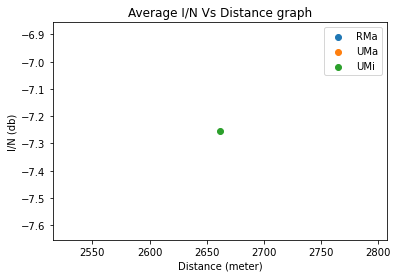

In [33]:
for key in pairs:
  plt.scatter(pairs[key][0], pairs[key][1], label=key)

plt.title('Average I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

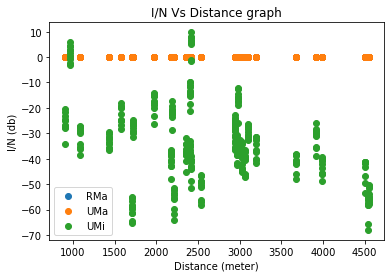

In [34]:
for key in pairs_noAverage:
  plt.scatter(pairs_noAverage[key][0], pairs_noAverage[key][1], label=key)

plt.title('I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-20 14:44:27,982 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


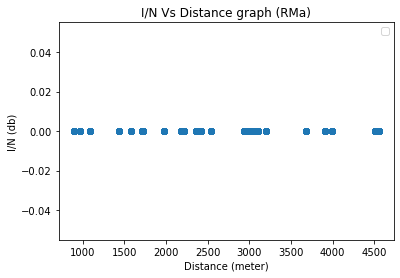

In [35]:
distance, interface_Noise = pairs_noAverage['RMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-20 14:44:28,062 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


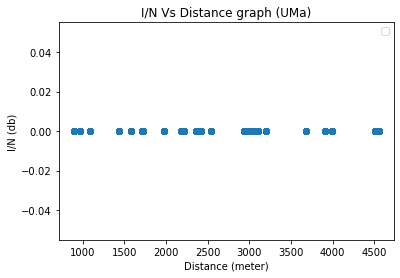

In [36]:
distance, interface_Noise = pairs_noAverage['UMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-20 14:44:28,141 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


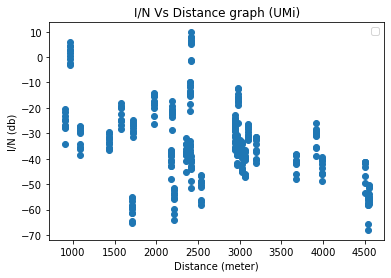

In [37]:
distance, interface_Noise = pairs_noAverage['UMi']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

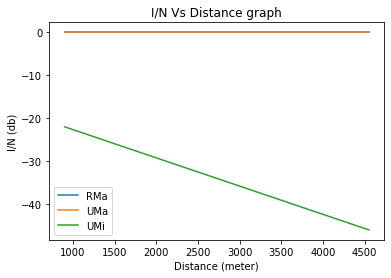

In [38]:
for key in pairs_noAverage:
  distance, interface_Noise = pairs_noAverage[key]
  distance_1D = np.array([])
  for arr in distance:
    distance_1D = np.append(distance_1D, arr)
  interface_Noise_1D = np.array([])
  for arr in interface_Noise:
    interface_Noise_1D = np.append(interface_Noise_1D, arr)
  distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance_1D, interface_Noise_1D)))
  coefficients = np.polyfit(distance_sorted, interface_Noise_sorted,1)
  # y = ax + b, where y is the average of interface_Noise_sorted
  plt.plot(np.array(distance_sorted), np.polyval(coefficients, distance_sorted), label=key)

plt.title('I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-20 14:44:28,367 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


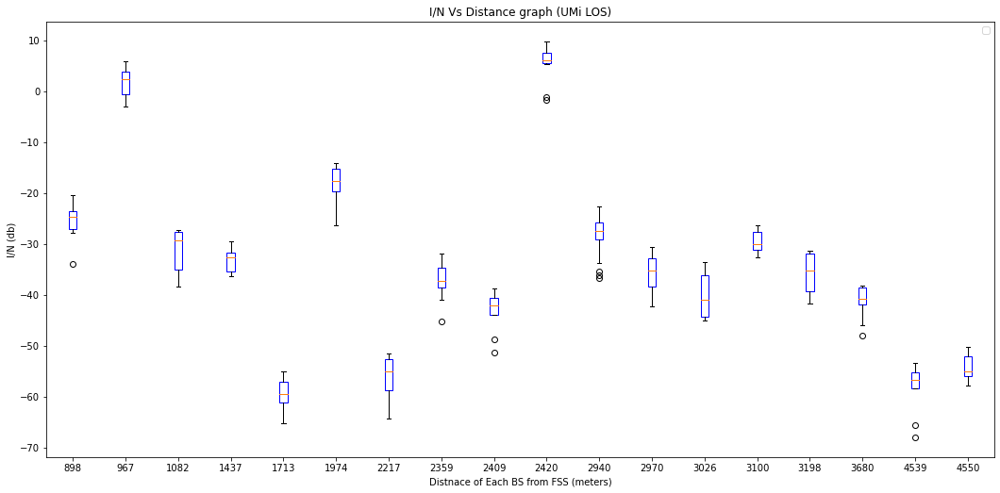

In [39]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if not line_of_sight[i]:
        continue   
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi LOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

2022-11-20 14:44:28,542 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


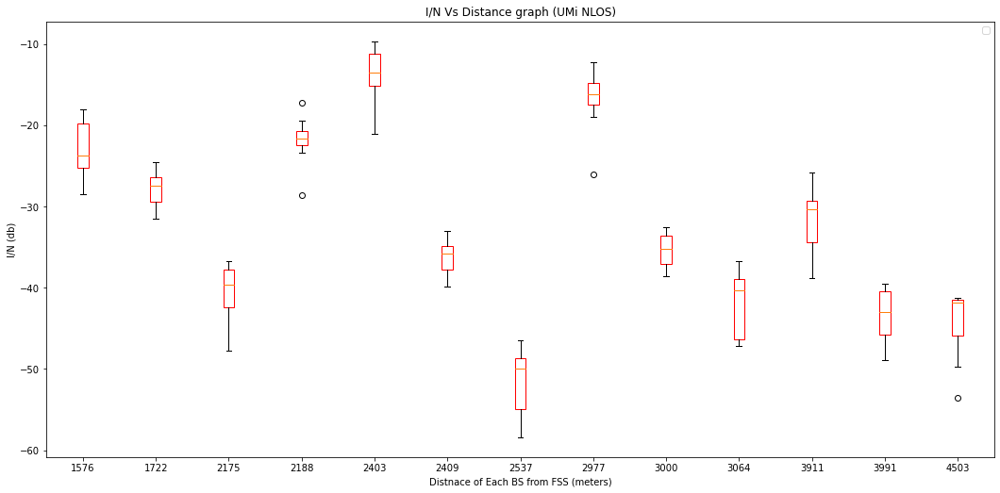

In [40]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

2022-11-20 14:44:28,710 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


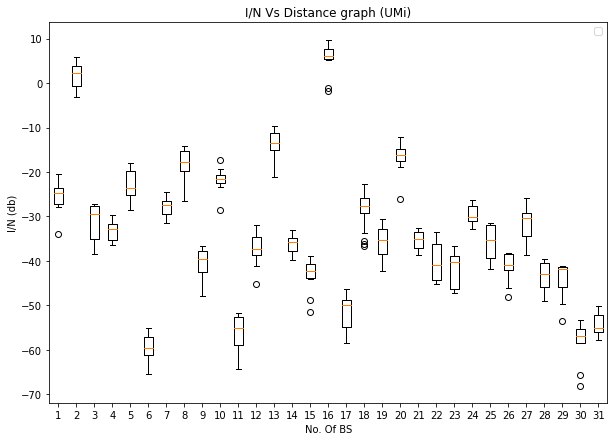

In [41]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
#show plot
plt.show()
# plt.save

2022-11-20 14:44:28,947 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


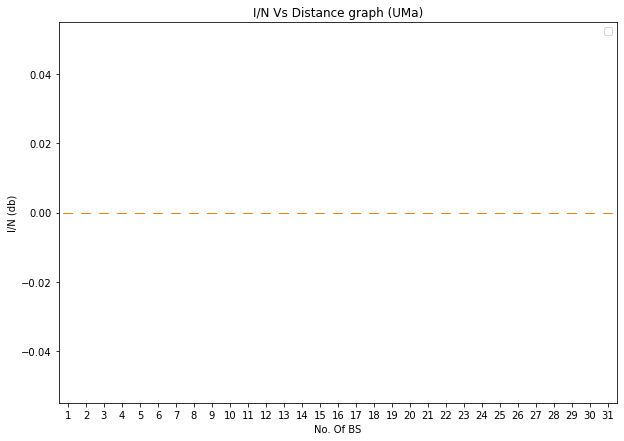

In [42]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
plt.boxplot([box_dict_UMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
# show plot
plt.show()


2022-11-20 14:44:29,170 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


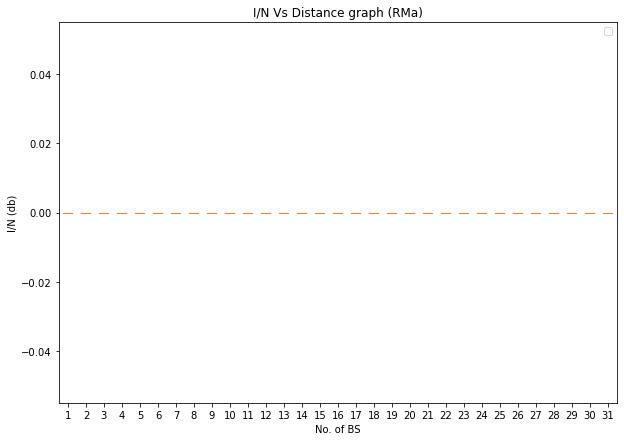

In [43]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
plt.boxplot([box_dict_RMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('No. of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
# show plot
# plt.show()

 
# show plot
plt.show()

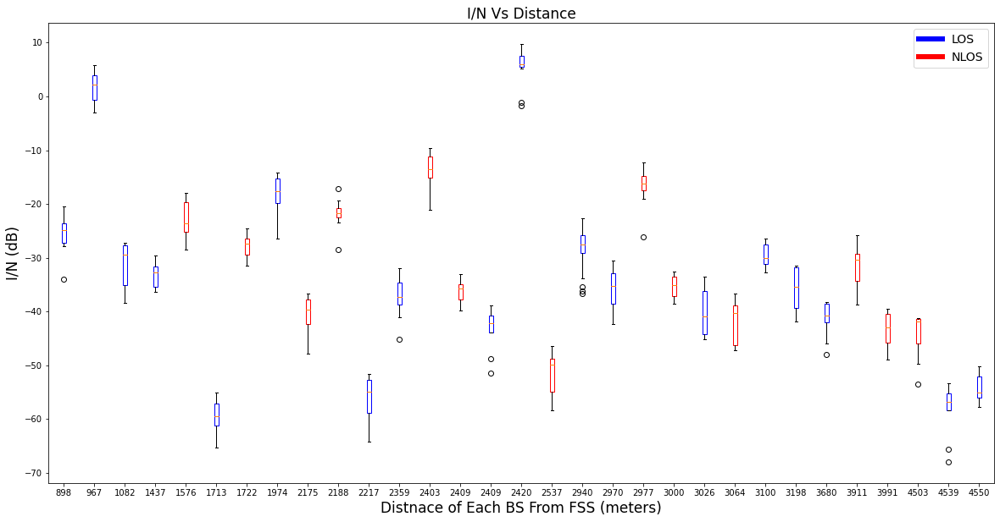

In [126]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], color='blue', lw=6),
                Line2D([0], [0], color='red', lw=6)]

ax.legend(custom_lines, ['LOS','NLOS' ],fontsize=14)
ax.set_xticklabels([int(i) for i in keys])
ax.set_title('I/N Vs Distance', fontsize=17)
ax.set_xlabel('Distnace of Each BS From FSS (meters)',fontsize=17)
ax.set_ylabel('I/N (dB)',fontsize=17)
fig.set_size_inches(20, 10)
fig.savefig('direct_graphUmi.pdf', dpi=100)
# plt.show()


In [58]:
box_dict_UMi 

{3680.0301623853043: [[-48.00669920521138, 1.0],
  [-42.13580327404803, 1.0],
  [-41.135840834188414, 1.0],
  [-41.668938323620694, 1.0],
  [-45.99789986269238, 1.0],
  [-40.540157551049916, 1.0],
  [-38.36008794808835, 1.0],
  [-38.233715121995616, 1.0],
  [-38.59232715163606, 1.0],
  [-38.5123458607594, 1.0]],
 1437.4931689011898: [[-33.291228914142025, 1.0],
  [-31.62701178850487, 1.0],
  [-34.19572358406654, 1.0],
  [-35.758100592298526, 1.0],
  [-35.82074674585872, 1.0],
  [-36.38910914828188, 1.0],
  [-29.60475593720048, 1.0],
  [-32.16177219193986, 1.0],
  [-31.875938025075857, 1.0],
  [-30.367800873183803, 1.0]],
 3000.1841379223347: [[-36.407214700729114, 0.0],
  [-37.293193441536786, 0.0],
  [-36.154809037522156, 0.0],
  [-32.509602262101815, 0.0],
  [-38.618283724043735, 0.0],
  [-33.63066456919688, 0.0],
  [-37.441710288574356, 0.0],
  [-33.59413616361505, 0.0],
  [-33.53183535177819, 0.0],
  [-34.158797931071106, 0.0]],
 2977.1909502839576: [[-18.97594715264204, 0.0],
  [-

In [52]:
pairs_noAverage['UMi'] [1]


array([-48.00669921, -33.29122891, -36.4072147 , -18.97594715,
       -37.20285867, -43.71910602, -13.17493668, -53.9300633 ,
       -24.75417669, -30.71524505, -37.45310619, -26.47354054,
       -32.36811468, -53.36638384, -24.58000724,   6.56971045,
         4.38461441, -24.7003197 , -59.13844216, -41.82964702,
       -51.93111915, -28.69095235, -34.9925271 , -39.49311261,
       -23.40222872, -41.84546593, -26.60973405, -44.75481217,
       -24.9892608 , -25.83843498, -29.25511489, -38.34890946,
       -49.00168809, -42.13580327, -31.62701179, -37.29319344,
       -17.53427508, -36.27358019, -42.90785483,  -9.63931575,
       -50.90030166, -25.34530105, -35.59831271, -36.68980013,
       -18.72596415, -38.56715772, -68.01532039, -26.87424291,
         5.91783982,   0.27510989, -20.52306051, -55.54451712,
       -41.48045843, -51.63702742, -36.27771274, -34.86970244,
       -40.92535363, -21.75200321, -32.44546901, -31.19623405,
       -39.74314308, -28.54718703, -27.35745376, -36.67

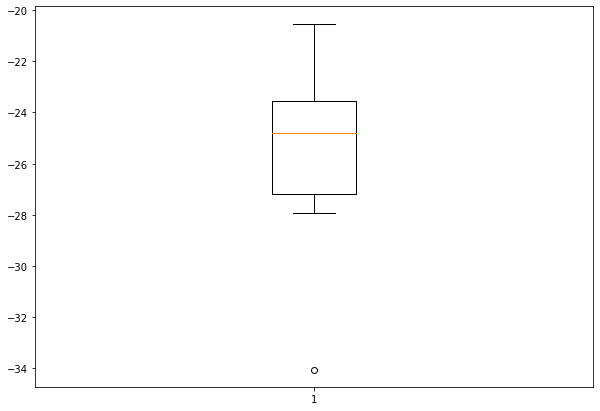

In [45]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys][0])
# ax.set_xticklabels([keys[0]])
 
# show plot
plt.show()


In [46]:
# # Creating dataset
# box_dict_UMi = dict()
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append(interface_Noise[i])

# elevation_dict_UMi = dict()

# for p in range (len(BS_X)):
#     x, y, z = BS_X[p]-FSS_X[0], BS_Y[p]-FSS_Y[0], 10-FSS_Z[0]

#     distance_2D = math.sqrt(((FSS_X[0]-BS_X[p])**2)+((FSS_Y[0]- BS_Y[p])**2)+((FSS_Z[0]-10)**2))

#     theta_bs_es = math.degrees(math.atan(y/x)) % 360
#     phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
#     fss_phi_difference = abs(15 - phi_bs_es)

    
#     if distance_2D in box_dict_UMi:
#         elevation_dict_UMi[fss_phi_difference] = box_dict_UMi[distance_2D]

# plt.title('I/N Vs Elevation graph (UMi)')
# plt.xlabel('Elevation (degrees)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()


In [47]:
# elevation_dict_UMi

2022-11-20 14:44:29,894 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


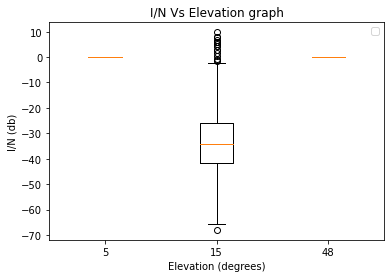

In [48]:
#Elevation angles (FSS towards to sky )
fig, ax=plt.subplots()

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}

contexts = sorted([context for context in FSS_phi], key=lambda x:FSS_phi[x])
boxplots = []

boxplots=ax.boxplot([pairs_noAverage[context][1] for context in contexts])
# for context in contexts:
#     distance, interface_Noise = pairs_noAverage[context]
#     boxplots.append(plt.boxplot(interface_Noise))

ax.set_xticklabels([FSS_phi[context] for context in contexts])

ax.set_title('I/N Vs Elevation graph')
ax.set_xlabel('Elevation (degrees)')
ax.set_ylabel('I/N (db)')
ax.legend()
plt.show()

2022-11-20 14:44:30,046 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


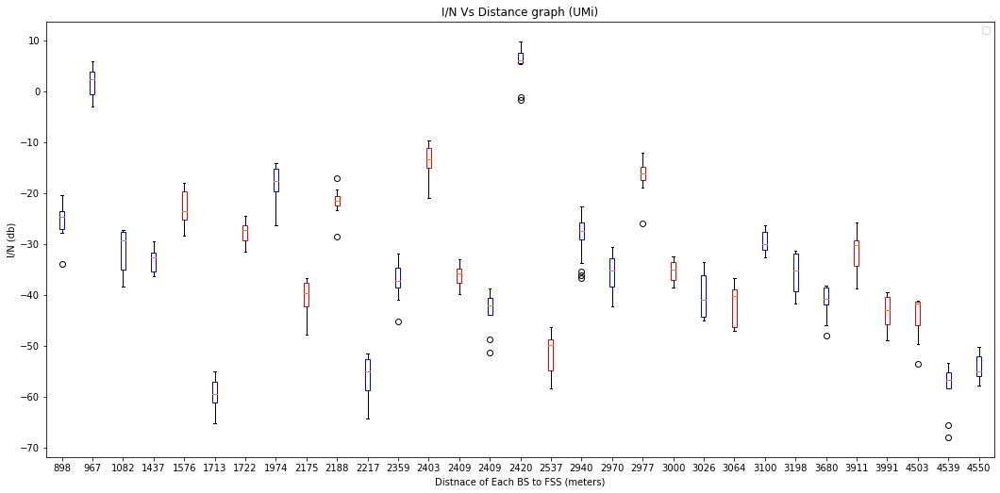

In [49]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmi.pdf', dpi=100)
plt.show()

2022-11-20 14:44:30,334 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


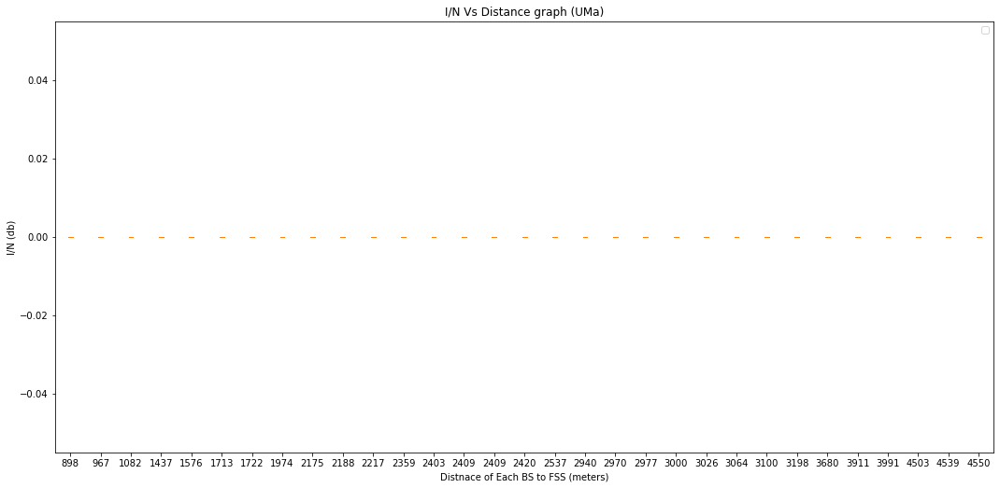

In [50]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUMa.pdf', dpi=100)
plt.show()

2022-11-20 14:44:31,073 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


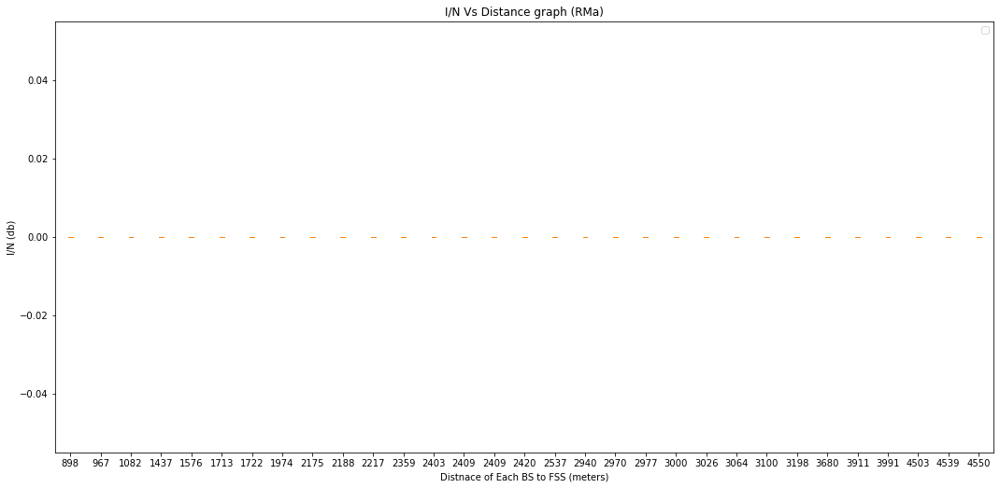

In [51]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()